# U-net for parcellation
## + L-net for regression
## + Fine-tuning on OTS manual labels
  
  
    
  
- trained on cortical parcellations from Freesurfer
- (TO DO) finetuned on small dataset of "expert" hand-labels
- predicts output class for each pixel of input image

In [1]:
import user

In [2]:
# I also like to live dangerously
import warnings
warnings.filterwarnings('ignore')

In [3]:
import unet

In [4]:
from user.data import ToFloat
from user.utils import y_vis_sample, from_onehot

import torch
from torch.utils.data import Dataset, DataLoader

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import torchvision
import torchvision.transforms as transforms

# these are required for defining the regession ImageFolder
from typing import Dict, Any
from torchvision import datasets
from torchsummary import summary

import nilearn as ni
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from matplotlib import colors

import os
import copy
import pickle
import collections

import numpy as np
import pandas as pd

from PIL import Image
from PIL import ImageOps
from PIL import ImagePalette

## 1. Set up directories and process data

In [5]:
model_save_dir = './model_checkpoints_parcellation-5-13.2'
os.makedirs(model_save_dir, exist_ok=True)

In [6]:
in_channels = 1
out_channels = 21

In [295]:
os.listdir(xchannel_dir_trn)[0][:-12]

'5122_T1.long.5122-212.21-95.43-'

In [309]:
def make_mapping_file(xdir, ydir, ldir, mapping_fname=None, 
                      xmask_dir=None, return_df=False,
                      xsplit_string='curv'):
    if mapping_fname is None:
        mapping_fname = 'mapping_file.csv'
    
    x_fnames = os.listdir(xdir)
    y_fnames = os.listdir(ydir)
    
    x_id = [''.join(f.split(xsplit_string))[:-4] for f in x_fnames]
    y_id = [''.join(f.split('parc'))[:-4]for f in y_fnames]

    x_df = pd.DataFrame({'Xname': x_fnames, 'ID': x_id})
    y_df = pd.DataFrame({'Yname': y_fnames, 'ID': y_id})

    mapping_df = pd.merge(x_df, y_df, how='inner', on='ID')
    mapping_df = mapping_df[['Xname', 'Yname', 'ID']]
    mapping_df.to_csv(f'{ldir}/{mapping_fname}', index=False, mode='w+')

In [310]:
def make_mapping_file_with_mask(xdir, ydir, ldir, mapping_fname=None, 
                                xmask_dir=None, return_df=False):
    if mapping_fname is None:
        mapping_fname = 'mapping_file.csv'
    
    x_fnames = os.listdir(xdir)
    xmask_fnames = os.listdir(xmask_dir)
    y_fnames = os.listdir(ydir)
    
    x_id = [''.join(f.split('curv'))[:-4] for f in x_fnames]
    xmask_id = [''.join(f.split('curv-mask'))[:-4] for f in xmask_fnames]
    y_id = [''.join(f.split('parc'))[:-4]for f in y_fnames]

    x_df = pd.DataFrame({'Xname': x_fnames, 'ID': x_id})
    xmask_df = pd.DataFrame({'Xmaskname': xmask_fnames, 'ID': xmask_id})
    y_df = pd.DataFrame({'Yname': y_fnames, 'ID': y_id})

    mapping_df = pd.merge(x_df, y_df, how='inner', on='ID')
    mapping_df = pd.merge(mapping_df, xmask_df, how='inner', on='ID')
    mapping_df = mapping_df[['Xname', 'Xmaskname', 'Yname', 'ID']]
    mapping_df.to_csv(f'{ldir}/{mapping_fname}', index=False, mode='w+')

## Create test-train split respecting subject EIDs

In [180]:
base_dir = '/scratch/groups/jyeatman/samjohns-projects/data/ots-images-jitter-processed'
xdir = base_dir + '/curv'
ydir = base_dir + '/parc'
ldir = base_dir

xdir_mask = base_dir + '/curv-mask'
xdir_mask_train = xdir_mask + '-trn'
xdir_mask_val = xdir_mask + '-val'

mapping_fname = 'ots_mapping_file_jitter.csv'
mapping_fname_mask = 'ots_mapping_file_mask.csv'

In [181]:
xdir_train = xdir + '-trn'
ydir_train = ydir + '-trn'
xdir_val = xdir + '-val'
ydir_val = ydir + '-val'

xs = os.listdir(xdir)
xs_mask = os.listdir(xdir_mask)
ys = os.listdir(ydir)

xeids = [s[:4] for s in xs]
yeids = [s[:4] for s in ys]

os.makedirs(xdir_train, exist_ok=True)
os.makedirs(ydir_train, exist_ok=True)
os.makedirs(xdir_val, exist_ok=True)
os.makedirs(ydir_val, exist_ok=True)

os.makedirs(xdir_mask_train, exist_ok=True)
os.makedirs(xdir_mask_val, exist_ok=True)

In [182]:
xmv = os.listdir(xdir_mask_val)
xv = os.listdir(xdir_val)

xmt = os.listdir(xdir_mask_train)
xt = os.listdir(xdir_train)

x = os.listdir(xdir)
xm = os.listdir(xdir_mask)

In [183]:
len(xmv), len(xmt), len(xv), len(xt), len(x), len(xm)

(0, 0, 200, 600, 800, 800)

In [184]:
x_df = pd.DataFrame({'x': x})
xm_df = pd.DataFrame({'xm': xm})
xm_df['ID'] = xm_df['xm'].apply(lambda s: s[:-13])
x_df['ID'] = x_df['x'].apply(lambda s: s[:-8])

# for training / validation split
xt_df = pd.DataFrame({'xt': xt})
xv_df = pd.DataFrame({'xv': xv})
xm_df = pd.DataFrame({'xm': xm})

x_df['ID'] = x_df['x'].apply(lambda s: s[:-8])
xt_df['ID'] = xt_df['xt'].apply(lambda s: s[:-8])
xv_df['ID'] = xv_df['xv'].apply(lambda s: s[:-8])
xm_df['ID'] = xm_df['xm'].apply(lambda s: s[:-13])

In [200]:
xms_train = list(pd.merge(xt_df, xm_df, on='ID', how='left')['xm'])
xms_val = list(pd.merge(xv_df, xm_df, on='ID', how='left')['xm'])

In [201]:
len(xms_train), len(xms_val), len(set(xms_train) & set(xms_val)) == 0

(600, 200, True)

In [202]:
# separate curv-mask files
# to be in accordance with curv file test-train split

make_mask_test_train_split = False  # False if cell already executed
if make_mask_test_train_split:

    import shutil
    for x in xm:
        trn = x in xms_train
        src = f'{xdir_mask}/{x}'
        dst = xdir_mask_train if trn else xdir_mask_val
        shutil.copy(src, dst)

In [203]:
len(set(xeids) & set(yeids)), len(set(xeids)), len(set(yeids))

(40, 40, 40)

In [204]:
xeids_unique = list(set(xeids))
yeids_unique = list(set(yeids))

val_size = len(xeids_unique) // 4
trn_size = len(xeids_unique) - val_size

(trn_size, val_size)

(30, 10)

In [205]:
copy_files = False
if copy_files:
    import shutil
    for y in ys:
        val = y[:4] in val_eids
        dst = ydir_val if val else ydir_train
        if val:
            shutil.copy(f'{ydir}/{y}', dst)
        else:
            shutil.copy(f'{ydir}/{y}', dst)

In [206]:
if copy_files:
    import shutil
    for x in xs:
        val = x[:4] in val_eids
        dst = xdir_val if val else xdir_train
        if val:
            shutil.copy(f'{xdir}/{x}', dst)
        else:
            shutil.copy(f'{xdir}/{x}', dst)

In [311]:
# make mapping files for train and val sets
# with mask

mapping_file_exists = True
mapping_fname_trn = 'mapping-ots-mask-trn.csv'
mapping_fname_val = 'mapping-ots-mask-val.csv'

if not mapping_file_exists:
    make_mapping_file(xchannel_dir_trn, ydir_train, ldir, mapping_fname_trn, xsplit_string='channels')
    make_mapping_file(xchannel_dir_val, ydir_val, ldir, mapping_fname_val, xsplit_string='channels')

In [312]:
trn_df = pd.read_csv(f'{ldir}/{mapping_fname_trn}')
val_df = pd.read_csv(f'{ldir}/{mapping_fname_val}')

In [313]:
val_df.head()

,Xname,Yname,ID
0,6121_T1.long.6121-206.46-104.42-channels.npy,6121_T1.long.6121-206.46-104.42-parc.npy,6121_T1.long.6121-206.46-104.42-
1,6032_T1.long.6032-205.91-90.28-channels.npy,6032_T1.long.6032-205.91-90.28-parc.npy,6032_T1.long.6032-205.91-90.28-
2,6115_T1.long.6115-205.34-80.39-channels.npy,6115_T1.long.6115-205.34-80.39-parc.npy,6115_T1.long.6115-205.34-80.39-
3,6032_T1.long.6032-212.43-103.82-channels.npy,6032_T1.long.6032-212.43-103.82-parc.npy,6032_T1.long.6032-212.43-103.82-
4,6113_T1.long.6113-218.03-100.99-channels.npy,6113_T1.long.6113-218.03-100.99-parc.npy,6113_T1.long.6113-218.03-100.99-


In [314]:
# test
trn_df.head()

,Xname,Yname,ID
0,5122_T1.long.5122-212.21-95.43-channels.npy,5122_T1.long.5122-212.21-95.43-parc.npy,5122_T1.long.5122-212.21-95.43-
1,6007_T1.long.6007-223.03-83.57-channels.npy,6007_T1.long.6007-223.03-83.57-parc.npy,6007_T1.long.6007-223.03-83.57-
2,6033_T1.long.6033-202.75-104.69-channels.npy,6033_T1.long.6033-202.75-104.69-parc.npy,6033_T1.long.6033-202.75-104.69-
3,5108_T1.long.5108-213.41-85.76-channels.npy,5108_T1.long.5108-213.41-85.76-parc.npy,5108_T1.long.5108-213.41-85.76-
4,5106_T1.long.5106-214.81-80.98-channels.npy,5106_T1.long.5106-214.81-80.98-parc.npy,5106_T1.long.5106-214.81-80.98-


In [315]:
len(trn_df), len(val_df) # nice, big dataset

(600, 200)

## 1.1 Create dataset(s)

### 1.1.1. Stitch curv and curv-mask files into combined np arrays

In [316]:
xchannel_dir = base_dir + '/xchannel'
xchannel_dir_trn = base_dir + '/xchannel-trn'
xchannel_dir_val = base_dir + '/xchannel-val'
os.makedirs(xchannel_dir, exist_ok=True)
os.makedirs(xchannel_dir_trn, exist_ok=True)
os.makedirs(xchannel_dir_val, exist_ok=True)

In [317]:
def np_onehot(x, n=None):
    """ Reshapes an array of integers into a one-hot-encoded
        vector of 0's and 1's by adding an extra dimension.
        Not in-place; returns the onehot np array.
    """
    if n is None:
        n = x.max() + 1
    return np.eye(n)[x.astype(int)]

def stitch_nps(np1, np2, second_to_onehot=True, n=None):
    if second_to_onehot:
        np2 = np_onehot(np2, n=n)
    np1 = np.expand_dims(np1, axis=2)
    np3 = np.concatenate((np1, np2), axis=2)
    return np3

def stitch_files(f1, f2, save_fname, second_to_onehot=True, n=None,
                 return_array=False):
    np1 = np.load(f1)
    np2 = np.load(f2)
    np3 = stitch_nps(np1, np2, second_to_onehot=second_to_onehot, n=n)
    with open(save_fname, 'wb') as f:
        np.save(f, np3)
    if return_array:
        return np3

In [289]:
already_split = True

In [290]:
# train
if not already_split:
    for i in range(len(trn_df)):

        row = trn_df.iloc[i]

        x = row['Xname']
        xm = row['Xmaskname']
        xid = row['ID']

        x_fpath = f'{xdir_train}/{x}'
        xm_fpath = f'{xdir_mask_train}/{xm}'
        save_fname = f'{xid}channels.npy'

        save_fpath = f'{xchannel_dir_trn}/{save_fname}'
        stitch_files(x_fpath, xm_fpath, save_fpath, n=3)

In [291]:
# val
if not already_split:
    for i in range(len(val_df)):

        row = val_df.iloc[i]

        x = row['Xname']
        xm = row['Xmaskname']
        xid = row['ID']

        x_fpath = f'{xdir_val}/{x}'
        xm_fpath = f'{xdir_mask_val}/{xm}'
        save_fname = f'{xid}channels.npy'

        save_fpath = f'{xchannel_dir_val}/{save_fname}'
        stitch_files(x_fpath, xm_fpath, save_fpath, n=3)

In [319]:
base_dir = '/scratch/groups/jyeatman/samjohns-projects/data/ots-images-jitter-processed'
xdir = base_dir + '/curv'
ydir = base_dir + '/parc'
ldir = base_dir

xdir_train = xdir + '-trn'
ydir_train = ydir + '-trn'
xdir_val = xdir + '-val'
ydir_val = ydir + '-val'

xs = os.listdir(xdir)
ys = os.listdir(ydir)

xeids = [s[:4] for s in xs]
yeids = [s[:4] for s in ys]

In [320]:
from user.data import aggregate_classes, _make_agg_matrix

n_out_channels = 7
null_agg_dict = {i: [i] for i in range(n_out_channels)}

# fg_agg_dict = {0: [0], 1: list(range(1, out_channels))}
# agg_dict = {0: [0], 1: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 13, 14, 16, 17, 18, 19, 20], 2: [11, 15]}

In [321]:
trf = transforms.Compose([transforms.ToTensor(), user.data.ToFloat()])
target_trf = transforms.Compose([transforms.ToTensor(), user.data.ToLong()])

In [28]:
mapping_fname_trn = 'mapping-ots-jitter-trn.csv'
mapping_fname_val = 'mapping-ots-jitter-val.csv'

mapping_file_trn = f'{base_dir}/{mapping_fname_trn}'
mapping_file_val = f'{base_dir}/{mapping_fname_val}'

In [29]:
ds_trn = user.data.CustomUnetDataset(xdir=xdir_train, ydir=ydir_train,
                                 mapping_file=mapping_file_trn,
                                 transform=trf,
                                 target_transform=target_trf, 
                                 nclasses=n_out_channels,
                                 agg_dict=null_agg_dict)

ds_val = user.data.CustomUnetDataset(xdir=xdir_val, ydir=ydir_val,
                                 mapping_file=mapping_file_val,
                                 transform=trf,
                                 target_transform=target_trf, 
                                 nclasses=n_out_channels,
                                 agg_dict=null_agg_dict)

In [32]:
len(ds_trn), len(ds_val)

(600, 200)

In [33]:
# create dataloaders

bs = 32
nw = 3  # number of cpu's to use to parallelize dl
pm = False  # whether to pin memory in dl

dl_train = DataLoader(ds_trn, batch_size=bs, shuffle=True, pin_memory=pm)
dl_test = DataLoader(ds_val, batch_size=bs, shuffle=False, pin_memory=pm)

## 1.1.2 Modify dataset to incorporate binary curvature masks

In [36]:
copy = False
if copy:
    import shutil
    for xf in xs_mask:
        trn = xf[:4] in trn_eids
        src = f'{xdir_mask}/{xf}'
        dst = xdir_mask_train if trn else xdir_mask_val
        dst = f'{dst}/{xf}'
        shutil.copyfile(src, dst)

In [37]:
len(os.listdir(xdir_mask_val))

224

In [41]:
xs_mask_val = os.listdir(xdir_mask_val)

In [43]:
x_mask_fp = f'{xdir_mask_val}/{xs_mask_val[0]}'
x_mask_np = np.load(x_mask_fp)

In [45]:
np.unique(x_mask_np, return_counts=True)

(array([0, 1, 2], dtype=uint8), array([55782,  5026,  4728]))

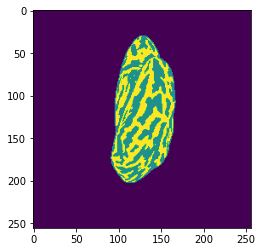

In [46]:
plt.imshow(x_mask_np)

In [52]:
x_mask_np_agg = x_mask_np.copy()
x_mask_np_agg[x_mask_np == 2] = 0

In [106]:
nmc = 3
x_mask = torch.Tensor(x_mask_np)
x_mask_onehot = F.one_hot(x_mask.to(torch.int64), nmc)

In [59]:
x_mask_onehot.shape

torch.Size([256, 256, 3])

In [ ]:
# create mapping file across subfolders



1. Make mapping file with masks
2. Make ds, dl with masks as channels
3. Promote code to dlutil

## 1.2 Visualize arrays

In [26]:
cmap = colors.ListedColormap(['white', 'blue', 'green', 'yellow', 'red', 'purple'])
bounds = [0, 1, 2, 3, 4, 5, 6]
norm = colors.BoundaryNorm(bounds, cmap.N)

In [27]:
di_test = iter(dl_test)
xte, yte = next(di_test)

In [28]:
testx = xte[0]
testy = yte[0]
xte.shape, yte.shape, xte.dtype, yte.dtype

(torch.Size([32, 1, 256, 256]),
 torch.Size([32, 7, 256, 256]),
 torch.float32,
 torch.float32)

In [29]:
ind_to_viz = 0

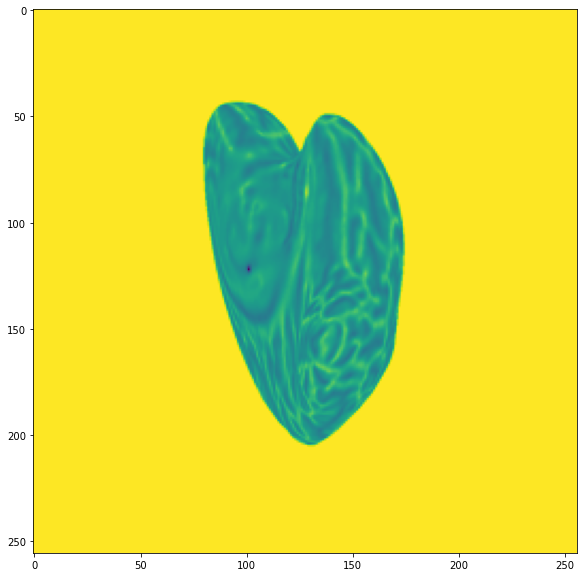

In [30]:
user.utils.imshow(xte[ind_to_viz])

In [21]:
testy_vis = y_vis_sample(yte[ind_to_viz])

In [22]:
testy_np = testy_vis.numpy().squeeze()

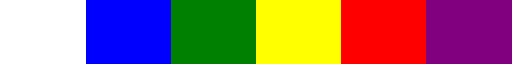

In [28]:
cmap

In [29]:
np.unique(testy_np, return_counts=True)

(array([0, 1, 2, 3, 5]), array([54307, 10711,   192,   288,    38]))

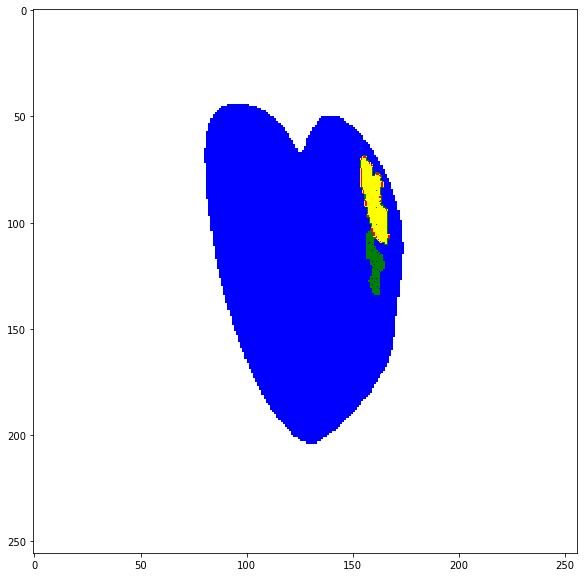

In [27]:
# note: option to specify cmap, e.g. tab20, appropriate for current # of classes
fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(testy_np, cmap=cmap, norm=norm) # cmap='tab20'

## 2. Define Unet and Fine-tune on OTS data

In [30]:
xtr, ytr = next(iter(dl_train))
xte, yte = next(iter(dl_test))

In [31]:
reset_model_var = False
if reset_model_var:
    del model

In [35]:
out_channels_agg = yte.shape[1]
in_channels = xte.shape[1]

In [36]:
model_base = unet.UNet(feature_count=in_channels, class_count=out_channels_agg, apply_sigmoid=False)

### 2.1 Optionally reload model from saved version

In [41]:
model_path = model_save_dir
model_ckpts = os.listdir(model_path)

In [42]:
sorted(model_ckpts)

['loss_history_0.pkl',
 'loss_history_100.pkl',
 'loss_history_1000.pkl',
 'loss_history_10000.pkl',
 'loss_history_10100.pkl',
 'loss_history_10200.pkl',
 'loss_history_10300.pkl',
 'loss_history_10400.pkl',
 'loss_history_10500.pkl',
 'loss_history_10600.pkl',
 'loss_history_10700.pkl',
 'loss_history_1100.pkl',
 'loss_history_1200.pkl',
 'loss_history_1300.pkl',
 'loss_history_1400.pkl',
 'loss_history_1500.pkl',
 'loss_history_1600.pkl',
 'loss_history_1700.pkl',
 'loss_history_1800.pkl',
 'loss_history_1900.pkl',
 'loss_history_200.pkl',
 'loss_history_2000.pkl',
 'loss_history_2100.pkl',
 'loss_history_2200.pkl',
 'loss_history_2300.pkl',
 'loss_history_2400.pkl',
 'loss_history_2500.pkl',
 'loss_history_2600.pkl',
 'loss_history_2700.pkl',
 'loss_history_2800.pkl',
 'loss_history_2900.pkl',
 'loss_history_300.pkl',
 'loss_history_3000.pkl',
 'loss_history_3100.pkl',
 'loss_history_3200.pkl',
 'loss_history_3300.pkl',
 'loss_history_3400.pkl',
 'loss_history_3500.pkl',
 'loss_his

load = True
if load:
    model.load_state_dict(torch.load(f'{model_path}/model007700.pkl'))

filter keys

In [34]:
model_fp = f'{model_save_dir}/model009000.pkl'
pretrained_params = torch.load(model_fp)

In [35]:
discard_keys = [k for k in list(pretrained_params.keys()) if 'conv_last' in k]
for k in discard_keys:
    pretrained_params.pop(k, None)
discard_keys, discard_keys[0] in pretrained_params.keys()

(['conv_last.weight', 'conv_last.bias'], False)

In [37]:
device = user.utils.get_device()
out_channels = 7
model = unet.UNet(feature_count=in_channels, class_count=out_channels_agg, apply_sigmoid=False)
model.to(device)
device

device(type='cuda', index=0)

In [38]:
def make_pretrained_state_dict(model_state, pretrained_state):
    pd = pretrained_state
    sd = model_state
    warmstart_params = copy.deepcopy(sd)
    for k, v in pd.items():
        warmstart_params[k] = v
    return warmstart_params

warmstart_params = make_pretrained_state_dict(model.state_dict(), pretrained_params)
model.load_state_dict(warmstart_params)

<All keys matched successfully>

In [39]:
# training proceeds along this plan
# shifts weight from bcd to dice
epochs = 50
training_plan = [
    dict(lr=0.00375, gamma=0.9, num_batches=int(1e4),  bce_weight=0.67),
    dict(lr=0.00250, gamma=0.9, num_batches=int(1e4),  bce_weight=0.33),
    dict(lr=0.00125, gamma=0.9, num_batches=int(1e4),  bce_weight=0.00)
]

training_plan_short = [dict(lr=0.00375, gamma=0.9, num_batches=int(1e5),  bce_weight=0.33)]

In [40]:
xtr.shape, ytr.shape, xte.shape, yte.shape

(torch.Size([32, 1, 256, 256]),
 torch.Size([32, 7, 256, 256]),
 torch.Size([32, 1, 256, 256]),
 torch.Size([32, 7, 256, 256]))

In [41]:
dl_dict = {'trn': dl_train, 'val': dl_test}

In [42]:
# freeze all but the last layer
user.utils.set_unfreeze_(model, [model.conv_last])

In [43]:
# confirm correct freeze / unfreeze
user.utils.check_requires_grad(model.conv_last), \
user.utils.check_requires_grad(model.conv_up3)

(True, False)

In [47]:
model_save_dir = '../models/unet/model_checkpoints_ots_finetuning-7-22.1'
os.makedirs(model_save_dir, exist_ok=True)

In [46]:
tp = training_plan  # abbreviated for testing
for e, t in enumerate(tp):
    # get hyperparameters
    lr = t['lr']
    gamma = t['gamma']
    bce_weight = t['bce_weight']
    num_batches = t['num_batches']

    # define training objects
    # Create the optimizer.
    optimizer = torch.optim.Adam(
        filter(lambda p: p.requires_grad, model.parameters()), lr=lr)
    # Next, create the scheduler.
    step_size = len(dl_dict['trn']) 
    scheduler = torch.optim.lr_scheduler.StepLR(
        optimizer,
        step_size=step_size,
        gamma=gamma)

    # train 
    model, best_dice, best_bce, losses = unet.train.train_model(model, optimizer, scheduler, dl_dict, 
                                 save_path=model_save_dir, report_every=5, checkpoint_every=50,
                                 logits=True, num_batches=num_batches,
                                                 logger=None)

Train loss: 9.62599; Val loss: 3.77302; Val bce: 6.67548; Val dice: 0.87056
Train loss: 1.13343; Val loss: 1.00311; Val bce: 1.28844; Val dice: 0.71779
Train loss: 0.56671; Val loss: 0.55078; Val bce: 0.39589; Val dice: 0.70566
Train loss: 0.46920; Val loss: 0.49791; Val bce: 0.28955; Val dice: 0.70627
Train loss: 0.40928; Val loss: 0.42241; Val bce: 0.17444; Val dice: 0.67039
Train loss: 0.40696; Val loss: 0.40324; Val bce: 0.15928; Val dice: 0.64721
Train loss: 0.37374; Val loss: 0.08836; Val bce: 0.02880; Val dice: 0.14792
Train loss: 0.35301; Val loss: 0.34590; Val bce: 0.13660; Val dice: 0.55520
Train loss: 0.31172; Val loss: 0.31768; Val bce: 0.13567; Val dice: 0.49970
Train loss: 0.28348; Val loss: 0.29796; Val bce: 0.12771; Val dice: 0.46820
Train loss: 0.30159; Val loss: 0.28570; Val bce: 0.11765; Val dice: 0.45374
Train loss: 0.27265; Val loss: 0.27744; Val bce: 0.11025; Val dice: 0.44463
Train loss: 0.26436; Val loss: 0.26721; Val bce: 0.10623; Val dice: 0.42819
Train loss: 

Train loss: 0.19139; Val loss: 0.20182; Val bce: 0.06613; Val dice: 0.33751
Train loss: 0.20640; Val loss: 0.20194; Val bce: 0.06617; Val dice: 0.33770
Train loss: 0.20388; Val loss: 0.20178; Val bce: 0.06605; Val dice: 0.33751
Train loss: 0.19381; Val loss: 0.20154; Val bce: 0.06595; Val dice: 0.33714
Train loss: 0.20248; Val loss: 0.20146; Val bce: 0.06592; Val dice: 0.33700
Train loss: 0.19783; Val loss: 0.20142; Val bce: 0.06597; Val dice: 0.33687
Train loss: 0.21757; Val loss: 0.20136; Val bce: 0.06595; Val dice: 0.33677
Train loss: 0.19133; Val loss: 0.20134; Val bce: 0.06593; Val dice: 0.33674
Train loss: 0.20602; Val loss: 0.20134; Val bce: 0.06598; Val dice: 0.33671
Train loss: 0.18998; Val loss: 0.20152; Val bce: 0.06616; Val dice: 0.33688
Train loss: 0.20667; Val loss: 0.20147; Val bce: 0.06611; Val dice: 0.33683
Train loss: 0.19763; Val loss: 0.20143; Val bce: 0.06606; Val dice: 0.33681
Train loss: 0.19862; Val loss: 0.20136; Val bce: 0.06592; Val dice: 0.33680
Train loss: 

Train loss: 0.20160; Val loss: 0.20065; Val bce: 0.06522; Val dice: 0.33607
Train loss: 0.18110; Val loss: 0.20054; Val bce: 0.06515; Val dice: 0.33593
Train loss: 0.21794; Val loss: 0.20060; Val bce: 0.06520; Val dice: 0.33600
Train loss: 0.17685; Val loss: 0.20045; Val bce: 0.06507; Val dice: 0.33583
Train loss: 0.19480; Val loss: 0.20056; Val bce: 0.06515; Val dice: 0.33596
Train loss: 0.18413; Val loss: 0.20055; Val bce: 0.06514; Val dice: 0.33596
Train loss: 0.21245; Val loss: 0.20056; Val bce: 0.06513; Val dice: 0.33598
Train loss: 0.20150; Val loss: 0.20055; Val bce: 0.06514; Val dice: 0.33595
Train loss: 0.20270; Val loss: 0.20050; Val bce: 0.06511; Val dice: 0.33588
Train loss: 0.19193; Val loss: 0.20058; Val bce: 0.06516; Val dice: 0.33599
Train loss: 0.20268; Val loss: 0.20051; Val bce: 0.06511; Val dice: 0.33591
Train loss: 0.20856; Val loss: 0.20062; Val bce: 0.06520; Val dice: 0.33603
Train loss: 0.20033; Val loss: 0.20063; Val bce: 0.06519; Val dice: 0.33607
Train loss: 

Train loss: 0.19524; Val loss: 0.20053; Val bce: 0.06513; Val dice: 0.33593
Train loss: 0.20139; Val loss: 0.20041; Val bce: 0.06503; Val dice: 0.33579
Train loss: 0.20115; Val loss: 0.20044; Val bce: 0.06506; Val dice: 0.33581
Train loss: 0.20288; Val loss: 0.20052; Val bce: 0.06512; Val dice: 0.33592
Train loss: 0.18568; Val loss: 0.20060; Val bce: 0.06520; Val dice: 0.33601
Train loss: 0.19950; Val loss: 0.20058; Val bce: 0.06516; Val dice: 0.33599
Train loss: 0.18956; Val loss: 0.20064; Val bce: 0.06520; Val dice: 0.33607
Train loss: 0.19978; Val loss: 0.20058; Val bce: 0.06516; Val dice: 0.33601
Train loss: 0.21277; Val loss: 0.20057; Val bce: 0.06515; Val dice: 0.33600
Train loss: 0.19307; Val loss: 0.20050; Val bce: 0.06509; Val dice: 0.33591
Train loss: 0.21243; Val loss: 0.20059; Val bce: 0.06517; Val dice: 0.33600
Train loss: 0.19281; Val loss: 0.20060; Val bce: 0.06518; Val dice: 0.33602
Train loss: 0.19391; Val loss: 0.20064; Val bce: 0.06522; Val dice: 0.33606
Train loss: 

Train loss: 0.20086; Val loss: 0.20058; Val bce: 0.06518; Val dice: 0.33598
Train loss: 0.17831; Val loss: 0.20061; Val bce: 0.06520; Val dice: 0.33602
Train loss: 0.20459; Val loss: 0.20051; Val bce: 0.06512; Val dice: 0.33590
Train loss: 0.21315; Val loss: 0.20044; Val bce: 0.06507; Val dice: 0.33582
Train loss: 0.19755; Val loss: 0.20036; Val bce: 0.06499; Val dice: 0.33573
Train loss: 0.20356; Val loss: 0.20043; Val bce: 0.06504; Val dice: 0.33582
Train loss: 0.21201; Val loss: 0.20043; Val bce: 0.06504; Val dice: 0.33582
Train loss: 0.20536; Val loss: 0.20057; Val bce: 0.06517; Val dice: 0.33597
Train loss: 0.21752; Val loss: 0.20061; Val bce: 0.06521; Val dice: 0.33601
Train loss: 0.20060; Val loss: 0.20058; Val bce: 0.06519; Val dice: 0.33597
Train loss: 0.20866; Val loss: 0.20055; Val bce: 0.06515; Val dice: 0.33594
Train loss: 0.19821; Val loss: 0.20061; Val bce: 0.06521; Val dice: 0.33601
Train loss: 0.19932; Val loss: 0.20052; Val bce: 0.06514; Val dice: 0.33590
Train loss: 

Train loss: 0.20072; Val loss: 0.20059; Val bce: 0.06518; Val dice: 0.33600
Train loss: 0.20007; Val loss: 0.20066; Val bce: 0.06524; Val dice: 0.33608
Train loss: 0.20227; Val loss: 0.20053; Val bce: 0.06513; Val dice: 0.33593
Train loss: 0.20372; Val loss: 0.20057; Val bce: 0.06517; Val dice: 0.33596
Train loss: 0.18977; Val loss: 0.20047; Val bce: 0.06508; Val dice: 0.33585
Train loss: 0.19001; Val loss: 0.20043; Val bce: 0.06504; Val dice: 0.33581
Train loss: 0.20761; Val loss: 0.20036; Val bce: 0.06500; Val dice: 0.33573
Train loss: 0.19214; Val loss: 0.20043; Val bce: 0.06506; Val dice: 0.33581
Train loss: 0.18495; Val loss: 0.20039; Val bce: 0.06503; Val dice: 0.33575
Train loss: 0.18326; Val loss: 0.20047; Val bce: 0.06510; Val dice: 0.33584
Train loss: 0.18443; Val loss: 0.20044; Val bce: 0.06507; Val dice: 0.33582
Train loss: 0.20081; Val loss: 0.20039; Val bce: 0.06502; Val dice: 0.33576
Train loss: 0.18661; Val loss: 0.20046; Val bce: 0.06507; Val dice: 0.33586
Train loss: 

Train loss: 0.19303; Val loss: 0.20048; Val bce: 0.06506; Val dice: 0.33590
Train loss: 0.18287; Val loss: 0.20044; Val bce: 0.06504; Val dice: 0.33583
Train loss: 0.20268; Val loss: 0.20041; Val bce: 0.06504; Val dice: 0.33578
Train loss: 0.18967; Val loss: 0.20052; Val bce: 0.06513; Val dice: 0.33590
Train loss: 0.19521; Val loss: 0.20057; Val bce: 0.06518; Val dice: 0.33597
Train loss: 0.19430; Val loss: 0.20063; Val bce: 0.06524; Val dice: 0.33602
Train loss: 0.20119; Val loss: 0.20056; Val bce: 0.06517; Val dice: 0.33596
Train loss: 0.20213; Val loss: 0.20060; Val bce: 0.06518; Val dice: 0.33602
Train loss: 0.21129; Val loss: 0.20065; Val bce: 0.06523; Val dice: 0.33607
Train loss: 0.18564; Val loss: 0.20056; Val bce: 0.06515; Val dice: 0.33598
Train loss: 0.20276; Val loss: 0.20064; Val bce: 0.06521; Val dice: 0.33607
Train loss: 0.19019; Val loss: 0.20055; Val bce: 0.06514; Val dice: 0.33597
Train loss: 0.19588; Val loss: 0.20059; Val bce: 0.06517; Val dice: 0.33600
Train loss: 

Train loss: 0.20116; Val loss: 0.20051; Val bce: 0.06513; Val dice: 0.33589
Train loss: 0.21350; Val loss: 0.20059; Val bce: 0.06520; Val dice: 0.33598
Train loss: 0.21230; Val loss: 0.20050; Val bce: 0.06512; Val dice: 0.33587
Train loss: 0.19290; Val loss: 0.20038; Val bce: 0.06502; Val dice: 0.33574
Train loss: 0.20535; Val loss: 0.20056; Val bce: 0.06518; Val dice: 0.33594
Train loss: 0.18989; Val loss: 0.20054; Val bce: 0.06515; Val dice: 0.33593
Train loss: 0.19335; Val loss: 0.20061; Val bce: 0.06521; Val dice: 0.33601
Train loss: 0.18751; Val loss: 0.20052; Val bce: 0.06513; Val dice: 0.33590
Train loss: 0.20306; Val loss: 0.20052; Val bce: 0.06512; Val dice: 0.33592
Train loss: 0.18803; Val loss: 0.20052; Val bce: 0.06512; Val dice: 0.33593
Train loss: 0.20129; Val loss: 0.20058; Val bce: 0.06519; Val dice: 0.33597
Train loss: 0.19426; Val loss: 0.20066; Val bce: 0.06523; Val dice: 0.33609
Train loss: 0.20062; Val loss: 0.20060; Val bce: 0.06517; Val dice: 0.33603
Train loss: 

Train loss: 0.19273; Val loss: 0.20057; Val bce: 0.06518; Val dice: 0.33596
Train loss: 0.20216; Val loss: 0.20059; Val bce: 0.06519; Val dice: 0.33599
Train loss: 0.21089; Val loss: 0.20066; Val bce: 0.06524; Val dice: 0.33608
Train loss: 0.19087; Val loss: 0.20056; Val bce: 0.06516; Val dice: 0.33596
Train loss: 0.20255; Val loss: 0.20041; Val bce: 0.06503; Val dice: 0.33578
Train loss: 0.20231; Val loss: 0.20039; Val bce: 0.06501; Val dice: 0.33576
Train loss: 0.21183; Val loss: 0.20043; Val bce: 0.06503; Val dice: 0.33583
Train loss: 0.17767; Val loss: 0.20034; Val bce: 0.06496; Val dice: 0.33571
Train loss: 0.20623; Val loss: 0.20037; Val bce: 0.06500; Val dice: 0.33575
Train loss: 0.20159; Val loss: 0.20052; Val bce: 0.06511; Val dice: 0.33592
Train loss: 0.20372; Val loss: 0.20044; Val bce: 0.06505; Val dice: 0.33583
Train loss: 0.21918; Val loss: 0.20066; Val bce: 0.06524; Val dice: 0.33607
Train loss: 0.20895; Val loss: 0.20056; Val bce: 0.06516; Val dice: 0.33595
Train loss: 

Train loss: 0.21406; Val loss: 0.20053; Val bce: 0.06515; Val dice: 0.33591
Train loss: 0.20766; Val loss: 0.20055; Val bce: 0.06515; Val dice: 0.33594
Train loss: 0.21709; Val loss: 0.20058; Val bce: 0.06517; Val dice: 0.33599
Train loss: 0.19937; Val loss: 0.20053; Val bce: 0.06513; Val dice: 0.33593
Train loss: 0.19113; Val loss: 0.20051; Val bce: 0.06510; Val dice: 0.33592
Train loss: 0.19651; Val loss: 0.20041; Val bce: 0.06501; Val dice: 0.33580
Train loss: 0.17231; Val loss: 0.20046; Val bce: 0.06505; Val dice: 0.33586
Train loss: 0.19873; Val loss: 0.20043; Val bce: 0.06502; Val dice: 0.33584
Train loss: 0.20432; Val loss: 0.20046; Val bce: 0.06506; Val dice: 0.33587
Train loss: 0.19236; Val loss: 0.20044; Val bce: 0.06505; Val dice: 0.33582
Train loss: 0.18224; Val loss: 0.20037; Val bce: 0.06501; Val dice: 0.33574
Train loss: 0.22050; Val loss: 0.20034; Val bce: 0.06499; Val dice: 0.33568
Train loss: 0.20996; Val loss: 0.20046; Val bce: 0.06508; Val dice: 0.33583
Train loss: 

Train loss: 0.18740; Val loss: 0.20049; Val bce: 0.06509; Val dice: 0.33589
Train loss: 0.20736; Val loss: 0.20062; Val bce: 0.06520; Val dice: 0.33604
Train loss: 0.20552; Val loss: 0.20066; Val bce: 0.06523; Val dice: 0.33609
Train loss: 0.20290; Val loss: 0.20050; Val bce: 0.06510; Val dice: 0.33590
Train loss: 0.20386; Val loss: 0.20050; Val bce: 0.06510; Val dice: 0.33590
Train loss: 0.19489; Val loss: 0.20050; Val bce: 0.06511; Val dice: 0.33590
Train loss: 0.19697; Val loss: 0.20046; Val bce: 0.06507; Val dice: 0.33585
Train loss: 0.19776; Val loss: 0.20053; Val bce: 0.06512; Val dice: 0.33593
Train loss: 0.19759; Val loss: 0.20053; Val bce: 0.06514; Val dice: 0.33592
Train loss: 0.21318; Val loss: 0.20051; Val bce: 0.06513; Val dice: 0.33590
Train loss: 0.20361; Val loss: 0.20059; Val bce: 0.06518; Val dice: 0.33599
Train loss: 0.21022; Val loss: 0.20057; Val bce: 0.06518; Val dice: 0.33595
Train loss: 0.21448; Val loss: 0.20056; Val bce: 0.06518; Val dice: 0.33595
Train loss: 

Train loss: 0.21394; Val loss: 0.20067; Val bce: 0.06525; Val dice: 0.33609
Train loss: 0.19651; Val loss: 0.20061; Val bce: 0.06519; Val dice: 0.33603
Train loss: 0.20152; Val loss: 0.20056; Val bce: 0.06514; Val dice: 0.33598
Train loss: 0.19157; Val loss: 0.20056; Val bce: 0.06515; Val dice: 0.33597
Train loss: 0.20336; Val loss: 0.20051; Val bce: 0.06512; Val dice: 0.33590
Train loss: 0.21073; Val loss: 0.20041; Val bce: 0.06505; Val dice: 0.33577
Train loss: 0.20857; Val loss: 0.20034; Val bce: 0.06497; Val dice: 0.33570
Train loss: 0.19657; Val loss: 0.20052; Val bce: 0.06512; Val dice: 0.33591
Train loss: 0.20174; Val loss: 0.20051; Val bce: 0.06514; Val dice: 0.33589
Train loss: 0.20182; Val loss: 0.20059; Val bce: 0.06518; Val dice: 0.33599
Train loss: 0.21039; Val loss: 0.20041; Val bce: 0.06503; Val dice: 0.33578
Train loss: 0.19867; Val loss: 0.20038; Val bce: 0.06500; Val dice: 0.33575
Train loss: 0.19923; Val loss: 0.20041; Val bce: 0.06503; Val dice: 0.33579
Train loss: 

Train loss: 0.20410; Val loss: 0.20034; Val bce: 0.06498; Val dice: 0.33570
Train loss: 0.20490; Val loss: 0.20044; Val bce: 0.06507; Val dice: 0.33581
Train loss: 0.18507; Val loss: 0.20052; Val bce: 0.06513; Val dice: 0.33590
Train loss: 0.18242; Val loss: 0.20028; Val bce: 0.06494; Val dice: 0.33563
Train loss: 0.19117; Val loss: 0.20044; Val bce: 0.06508; Val dice: 0.33580
Train loss: 0.19288; Val loss: 0.20051; Val bce: 0.06513; Val dice: 0.33589
Train loss: 0.19908; Val loss: 0.20045; Val bce: 0.06507; Val dice: 0.33583
Train loss: 0.18733; Val loss: 0.20038; Val bce: 0.06500; Val dice: 0.33575
Train loss: 0.19467; Val loss: 0.20056; Val bce: 0.06514; Val dice: 0.33597
Train loss: 0.18520; Val loss: 0.20048; Val bce: 0.06509; Val dice: 0.33588
Train loss: 0.20664; Val loss: 0.20049; Val bce: 0.06509; Val dice: 0.33588
Train loss: 0.19316; Val loss: 0.20043; Val bce: 0.06504; Val dice: 0.33582
Train loss: 0.20797; Val loss: 0.20048; Val bce: 0.06508; Val dice: 0.33588
Train loss: 

Train loss: 0.21408; Val loss: 0.20068; Val bce: 0.06528; Val dice: 0.33608
Train loss: 0.17858; Val loss: 0.20061; Val bce: 0.06520; Val dice: 0.33601
Train loss: 0.19508; Val loss: 0.20047; Val bce: 0.06509; Val dice: 0.33585
Train loss: 0.20416; Val loss: 0.20048; Val bce: 0.06510; Val dice: 0.33585
Train loss: 0.20212; Val loss: 0.20049; Val bce: 0.06510; Val dice: 0.33588
Train loss: 0.21139; Val loss: 0.20064; Val bce: 0.06523; Val dice: 0.33604
Train loss: 0.19349; Val loss: 0.20049; Val bce: 0.06510; Val dice: 0.33588
Train loss: 0.21057; Val loss: 0.20049; Val bce: 0.06509; Val dice: 0.33588
Train loss: 0.20684; Val loss: 0.20051; Val bce: 0.06513; Val dice: 0.33590
Train loss: 0.18625; Val loss: 0.20045; Val bce: 0.06507; Val dice: 0.33583
Train loss: 0.21977; Val loss: 0.20047; Val bce: 0.06509; Val dice: 0.33585
Train loss: 0.19583; Val loss: 0.20046; Val bce: 0.06507; Val dice: 0.33586
Train loss: 0.20675; Val loss: 0.20056; Val bce: 0.06514; Val dice: 0.33598
Train loss: 

Train loss: 0.20329; Val loss: 0.20050; Val bce: 0.06510; Val dice: 0.33590
Train loss: 0.18677; Val loss: 0.20041; Val bce: 0.06503; Val dice: 0.33579
Train loss: 0.18980; Val loss: 0.20044; Val bce: 0.06506; Val dice: 0.33582
Train loss: 0.19146; Val loss: 0.20041; Val bce: 0.06502; Val dice: 0.33580
Train loss: 0.19505; Val loss: 0.20043; Val bce: 0.06503; Val dice: 0.33583
Train loss: 0.18989; Val loss: 0.20045; Val bce: 0.06505; Val dice: 0.33584
Train loss: 0.20468; Val loss: 0.20047; Val bce: 0.06506; Val dice: 0.33587
Train loss: 0.20409; Val loss: 0.20051; Val bce: 0.06510; Val dice: 0.33593
Train loss: 0.20111; Val loss: 0.20052; Val bce: 0.06510; Val dice: 0.33594
Train loss: 0.19760; Val loss: 0.20032; Val bce: 0.06494; Val dice: 0.33570
Train loss: 0.19041; Val loss: 0.20057; Val bce: 0.06516; Val dice: 0.33597
Train loss: 0.20695; Val loss: 0.20041; Val bce: 0.06502; Val dice: 0.33579
Train loss: 0.18103; Val loss: 0.20038; Val bce: 0.06499; Val dice: 0.33578
Train loss: 

Train loss: 0.21855; Val loss: 0.20049; Val bce: 0.06511; Val dice: 0.33587
Train loss: 0.21064; Val loss: 0.20038; Val bce: 0.06501; Val dice: 0.33574
Train loss: 0.20441; Val loss: 0.20036; Val bce: 0.06499; Val dice: 0.33573
Train loss: 0.19693; Val loss: 0.20041; Val bce: 0.06503; Val dice: 0.33579
Train loss: 0.19846; Val loss: 0.20045; Val bce: 0.06507; Val dice: 0.33584
Train loss: 0.20542; Val loss: 0.20056; Val bce: 0.06516; Val dice: 0.33596
Train loss: 0.20269; Val loss: 0.20050; Val bce: 0.06511; Val dice: 0.33589
Train loss: 0.20821; Val loss: 0.20057; Val bce: 0.06517; Val dice: 0.33597
Train loss: 0.21010; Val loss: 0.20054; Val bce: 0.06515; Val dice: 0.33593
Train loss: 0.21508; Val loss: 0.20054; Val bce: 0.06514; Val dice: 0.33594
Train loss: 0.20404; Val loss: 0.20046; Val bce: 0.06507; Val dice: 0.33586
Train loss: 0.18454; Val loss: 0.20051; Val bce: 0.06510; Val dice: 0.33592
Train loss: 0.19795; Val loss: 0.20046; Val bce: 0.06507; Val dice: 0.33584
Train loss: 

Train loss: 0.19069; Val loss: 0.20068; Val bce: 0.06524; Val dice: 0.33612
Train loss: 0.19432; Val loss: 0.20051; Val bce: 0.06511; Val dice: 0.33591
Train loss: 0.20603; Val loss: 0.20037; Val bce: 0.06500; Val dice: 0.33575
Train loss: 0.20707; Val loss: 0.20043; Val bce: 0.06504; Val dice: 0.33582
Train loss: 0.20349; Val loss: 0.20053; Val bce: 0.06513; Val dice: 0.33593
Train loss: 0.20293; Val loss: 0.20042; Val bce: 0.06503; Val dice: 0.33581
Train loss: 0.20043; Val loss: 0.20061; Val bce: 0.06519; Val dice: 0.33603
Train loss: 0.18830; Val loss: 0.20048; Val bce: 0.06509; Val dice: 0.33588
Train loss: 0.20867; Val loss: 0.20041; Val bce: 0.06502; Val dice: 0.33579
Train loss: 0.19650; Val loss: 0.20041; Val bce: 0.06504; Val dice: 0.33579
Train loss: 0.19093; Val loss: 0.20050; Val bce: 0.06512; Val dice: 0.33589
Train loss: 0.19405; Val loss: 0.20054; Val bce: 0.06515; Val dice: 0.33593
Train loss: 0.20902; Val loss: 0.20063; Val bce: 0.06522; Val dice: 0.33604
Train loss: 

Train loss: 0.20752; Val loss: 0.20068; Val bce: 0.06524; Val dice: 0.33612
Train loss: 0.20574; Val loss: 0.20061; Val bce: 0.06519; Val dice: 0.33603
Train loss: 0.21012; Val loss: 0.20057; Val bce: 0.06516; Val dice: 0.33598
Train loss: 0.19431; Val loss: 0.20042; Val bce: 0.06503; Val dice: 0.33581
Train loss: 0.18995; Val loss: 0.20046; Val bce: 0.06505; Val dice: 0.33587
Train loss: 0.19381; Val loss: 0.20038; Val bce: 0.06500; Val dice: 0.33576
Train loss: 0.20399; Val loss: 0.20044; Val bce: 0.06507; Val dice: 0.33582
Train loss: 0.20189; Val loss: 0.20050; Val bce: 0.06510; Val dice: 0.33589
Train loss: 0.20208; Val loss: 0.20059; Val bce: 0.06518; Val dice: 0.33600
Train loss: 0.18109; Val loss: 0.20056; Val bce: 0.06516; Val dice: 0.33597
Train loss: 0.20449; Val loss: 0.20059; Val bce: 0.06520; Val dice: 0.33598
Train loss: 0.21864; Val loss: 0.20050; Val bce: 0.06513; Val dice: 0.33586
Train loss: 0.17869; Val loss: 0.20050; Val bce: 0.06513; Val dice: 0.33587
Train loss: 

Train loss: 0.19041; Val loss: 0.20044; Val bce: 0.06508; Val dice: 0.33580
Train loss: 0.19809; Val loss: 0.20064; Val bce: 0.06523; Val dice: 0.33605
Train loss: 0.20906; Val loss: 0.20060; Val bce: 0.06520; Val dice: 0.33601
Train loss: 0.20560; Val loss: 0.20057; Val bce: 0.06517; Val dice: 0.33597
Train loss: 0.20642; Val loss: 0.20058; Val bce: 0.06518; Val dice: 0.33597
Train loss: 0.19482; Val loss: 0.20044; Val bce: 0.06506; Val dice: 0.33582
Train loss: 0.21321; Val loss: 0.20055; Val bce: 0.06514; Val dice: 0.33596
Train loss: 0.18762; Val loss: 0.20060; Val bce: 0.06520; Val dice: 0.33601
Train loss: 0.20452; Val loss: 0.20058; Val bce: 0.06518; Val dice: 0.33597
Train loss: 0.19753; Val loss: 0.20055; Val bce: 0.06515; Val dice: 0.33596
Train loss: 0.19633; Val loss: 0.20057; Val bce: 0.06517; Val dice: 0.33597
Train loss: 0.18822; Val loss: 0.20061; Val bce: 0.06518; Val dice: 0.33604
Train loss: 0.19358; Val loss: 0.20056; Val bce: 0.06514; Val dice: 0.33597
Train loss: 

Train loss: 0.19009; Val loss: 0.19382; Val bce: 0.05673; Val dice: 0.33091
Train loss: 0.19808; Val loss: 0.19284; Val bce: 0.05512; Val dice: 0.33057
Train loss: 0.20177; Val loss: 0.19197; Val bce: 0.05485; Val dice: 0.32910
Train loss: 0.20835; Val loss: 0.19185; Val bce: 0.05605; Val dice: 0.32766
Train loss: 0.19976; Val loss: 0.19225; Val bce: 0.05677; Val dice: 0.32774
Train loss: 0.18776; Val loss: 0.19236; Val bce: 0.05602; Val dice: 0.32870
Train loss: 0.19735; Val loss: 0.19241; Val bce: 0.05548; Val dice: 0.32933
Train loss: 0.19714; Val loss: 0.19255; Val bce: 0.05559; Val dice: 0.32950
Train loss: 0.18454; Val loss: 0.19236; Val bce: 0.05568; Val dice: 0.32903
Train loss: 0.19121; Val loss: 0.19210; Val bce: 0.05576; Val dice: 0.32843
Train loss: 0.18013; Val loss: 0.19198; Val bce: 0.05539; Val dice: 0.32857
Train loss: 0.18607; Val loss: 0.19225; Val bce: 0.05551; Val dice: 0.32898
Train loss: 0.20756; Val loss: 0.19238; Val bce: 0.05558; Val dice: 0.32918
Train loss: 

Train loss: 0.18929; Val loss: 0.19248; Val bce: 0.05548; Val dice: 0.32947
Train loss: 0.18815; Val loss: 0.19246; Val bce: 0.05546; Val dice: 0.32946
Train loss: 0.20297; Val loss: 0.19259; Val bce: 0.05554; Val dice: 0.32964
Train loss: 0.20205; Val loss: 0.19251; Val bce: 0.05549; Val dice: 0.32952
Train loss: 0.19817; Val loss: 0.19255; Val bce: 0.05554; Val dice: 0.32956
Train loss: 0.18565; Val loss: 0.19248; Val bce: 0.05552; Val dice: 0.32943
Train loss: 0.19396; Val loss: 0.19247; Val bce: 0.05556; Val dice: 0.32938
Train loss: 0.20119; Val loss: 0.19237; Val bce: 0.05553; Val dice: 0.32921
Train loss: 0.17436; Val loss: 0.19252; Val bce: 0.05564; Val dice: 0.32941
Train loss: 0.19201; Val loss: 0.19258; Val bce: 0.05569; Val dice: 0.32947
Train loss: 0.20001; Val loss: 0.19256; Val bce: 0.05566; Val dice: 0.32946
Train loss: 0.20667; Val loss: 0.19254; Val bce: 0.05568; Val dice: 0.32941
Train loss: 0.19438; Val loss: 0.19263; Val bce: 0.05574; Val dice: 0.32952
Train loss: 

Train loss: 0.20202; Val loss: 0.19241; Val bce: 0.05558; Val dice: 0.32924
Train loss: 0.20219; Val loss: 0.19245; Val bce: 0.05561; Val dice: 0.32929
Train loss: 0.19116; Val loss: 0.19241; Val bce: 0.05558; Val dice: 0.32924
Train loss: 0.18878; Val loss: 0.19245; Val bce: 0.05561; Val dice: 0.32928
Train loss: 0.18391; Val loss: 0.19241; Val bce: 0.05559; Val dice: 0.32922
Train loss: 0.20561; Val loss: 0.19240; Val bce: 0.05559; Val dice: 0.32921
Train loss: 0.20871; Val loss: 0.19239; Val bce: 0.05558; Val dice: 0.32920
Train loss: 0.19891; Val loss: 0.19237; Val bce: 0.05557; Val dice: 0.32917
Train loss: 0.19805; Val loss: 0.19236; Val bce: 0.05558; Val dice: 0.32915
Train loss: 0.17525; Val loss: 0.19237; Val bce: 0.05558; Val dice: 0.32917
Train loss: 0.20032; Val loss: 0.19236; Val bce: 0.05556; Val dice: 0.32917
Train loss: 0.18005; Val loss: 0.19239; Val bce: 0.05557; Val dice: 0.32921
Train loss: 0.16795; Val loss: 0.19240; Val bce: 0.05558; Val dice: 0.32923
Train loss: 

Train loss: 0.19399; Val loss: 0.19253; Val bce: 0.05567; Val dice: 0.32940
Train loss: 0.18036; Val loss: 0.19243; Val bce: 0.05559; Val dice: 0.32927
Train loss: 0.17199; Val loss: 0.19247; Val bce: 0.05561; Val dice: 0.32932
Train loss: 0.18690; Val loss: 0.19242; Val bce: 0.05559; Val dice: 0.32925
Train loss: 0.19380; Val loss: 0.19251; Val bce: 0.05565; Val dice: 0.32938
Train loss: 0.20033; Val loss: 0.19238; Val bce: 0.05557; Val dice: 0.32920
Train loss: 0.17698; Val loss: 0.19226; Val bce: 0.05549; Val dice: 0.32902
Train loss: 0.19262; Val loss: 0.19227; Val bce: 0.05550; Val dice: 0.32904
Train loss: 0.18872; Val loss: 0.19227; Val bce: 0.05550; Val dice: 0.32903
Train loss: 0.20151; Val loss: 0.19235; Val bce: 0.05556; Val dice: 0.32913
Train loss: 0.19160; Val loss: 0.19243; Val bce: 0.05560; Val dice: 0.32925
Train loss: 0.18823; Val loss: 0.19242; Val bce: 0.05559; Val dice: 0.32924
Train loss: 0.18792; Val loss: 0.19233; Val bce: 0.05554; Val dice: 0.32912
Train loss: 

Train loss: 0.19288; Val loss: 0.19250; Val bce: 0.05565; Val dice: 0.32935
Train loss: 0.19679; Val loss: 0.19237; Val bce: 0.05556; Val dice: 0.32919
Train loss: 0.18854; Val loss: 0.19238; Val bce: 0.05557; Val dice: 0.32919
Train loss: 0.17851; Val loss: 0.19237; Val bce: 0.05556; Val dice: 0.32918
Train loss: 0.19445; Val loss: 0.19243; Val bce: 0.05561; Val dice: 0.32925
Train loss: 0.18956; Val loss: 0.19242; Val bce: 0.05560; Val dice: 0.32924
Train loss: 0.19760; Val loss: 0.19246; Val bce: 0.05564; Val dice: 0.32929
Train loss: 0.18735; Val loss: 0.19233; Val bce: 0.05555; Val dice: 0.32910
Train loss: 0.19784; Val loss: 0.19243; Val bce: 0.05560; Val dice: 0.32926
Train loss: 0.19423; Val loss: 0.19244; Val bce: 0.05560; Val dice: 0.32928
Train loss: 0.19832; Val loss: 0.19249; Val bce: 0.05565; Val dice: 0.32933
Train loss: 0.19940; Val loss: 0.19252; Val bce: 0.05565; Val dice: 0.32938
Train loss: 0.18123; Val loss: 0.19249; Val bce: 0.05564; Val dice: 0.32935
Train loss: 

Train loss: 0.17986; Val loss: 0.19244; Val bce: 0.05561; Val dice: 0.32928
Train loss: 0.19191; Val loss: 0.19242; Val bce: 0.05559; Val dice: 0.32925
Train loss: 0.18509; Val loss: 0.19246; Val bce: 0.05562; Val dice: 0.32930
Train loss: 0.15827; Val loss: 0.19233; Val bce: 0.05554; Val dice: 0.32913
Train loss: 0.19596; Val loss: 0.19240; Val bce: 0.05559; Val dice: 0.32921
Train loss: 0.19455; Val loss: 0.19246; Val bce: 0.05562; Val dice: 0.32929
Train loss: 0.17553; Val loss: 0.19256; Val bce: 0.05570; Val dice: 0.32942
Train loss: 0.19766; Val loss: 0.19247; Val bce: 0.05564; Val dice: 0.32929
Train loss: 0.20544; Val loss: 0.19235; Val bce: 0.05557; Val dice: 0.32913
Train loss: 0.19433; Val loss: 0.19241; Val bce: 0.05560; Val dice: 0.32922
Train loss: 0.19540; Val loss: 0.19241; Val bce: 0.05559; Val dice: 0.32923
Train loss: 0.19810; Val loss: 0.19246; Val bce: 0.05561; Val dice: 0.32930
Train loss: 0.20179; Val loss: 0.19248; Val bce: 0.05563; Val dice: 0.32934
Train loss: 

Train loss: 0.19260; Val loss: 0.19243; Val bce: 0.05559; Val dice: 0.32926
Train loss: 0.19618; Val loss: 0.19234; Val bce: 0.05554; Val dice: 0.32915
Train loss: 0.18950; Val loss: 0.19234; Val bce: 0.05555; Val dice: 0.32913
Train loss: 0.19732; Val loss: 0.19250; Val bce: 0.05563; Val dice: 0.32937
Train loss: 0.19799; Val loss: 0.19249; Val bce: 0.05563; Val dice: 0.32934
Train loss: 0.18781; Val loss: 0.19246; Val bce: 0.05562; Val dice: 0.32931
Train loss: 0.19371; Val loss: 0.19250; Val bce: 0.05564; Val dice: 0.32937
Train loss: 0.19468; Val loss: 0.19246; Val bce: 0.05562; Val dice: 0.32930
Train loss: 0.19885; Val loss: 0.19234; Val bce: 0.05554; Val dice: 0.32914
Train loss: 0.20163; Val loss: 0.19236; Val bce: 0.05555; Val dice: 0.32917
Train loss: 0.18205; Val loss: 0.19248; Val bce: 0.05562; Val dice: 0.32934
Train loss: 0.18755; Val loss: 0.19243; Val bce: 0.05561; Val dice: 0.32926
Train loss: 0.20240; Val loss: 0.19253; Val bce: 0.05567; Val dice: 0.32939
Train loss: 

Train loss: 0.19237; Val loss: 0.19243; Val bce: 0.05559; Val dice: 0.32927
Train loss: 0.19965; Val loss: 0.19243; Val bce: 0.05560; Val dice: 0.32926
Train loss: 0.19660; Val loss: 0.19247; Val bce: 0.05563; Val dice: 0.32930
Train loss: 0.21426; Val loss: 0.19246; Val bce: 0.05562; Val dice: 0.32930
Train loss: 0.17706; Val loss: 0.19237; Val bce: 0.05557; Val dice: 0.32918
Train loss: 0.19971; Val loss: 0.19248; Val bce: 0.05562; Val dice: 0.32935
Train loss: 0.19901; Val loss: 0.19250; Val bce: 0.05565; Val dice: 0.32936
Train loss: 0.20333; Val loss: 0.19251; Val bce: 0.05565; Val dice: 0.32937
Train loss: 0.19391; Val loss: 0.19245; Val bce: 0.05561; Val dice: 0.32928
Train loss: 0.18493; Val loss: 0.19238; Val bce: 0.05556; Val dice: 0.32921
Train loss: 0.20290; Val loss: 0.19239; Val bce: 0.05558; Val dice: 0.32921
Train loss: 0.18448; Val loss: 0.19245; Val bce: 0.05561; Val dice: 0.32928
Train loss: 0.19445; Val loss: 0.19246; Val bce: 0.05562; Val dice: 0.32929
Train loss: 

Train loss: 0.18222; Val loss: 0.19243; Val bce: 0.05561; Val dice: 0.32926
Train loss: 0.19758; Val loss: 0.19239; Val bce: 0.05558; Val dice: 0.32921
Train loss: 0.19054; Val loss: 0.19241; Val bce: 0.05558; Val dice: 0.32924
Train loss: 0.20698; Val loss: 0.19246; Val bce: 0.05562; Val dice: 0.32931
Train loss: 0.19400; Val loss: 0.19254; Val bce: 0.05566; Val dice: 0.32941
Train loss: 0.19828; Val loss: 0.19248; Val bce: 0.05563; Val dice: 0.32934
Train loss: 0.20224; Val loss: 0.19256; Val bce: 0.05568; Val dice: 0.32943
Train loss: 0.18914; Val loss: 0.19253; Val bce: 0.05566; Val dice: 0.32939
Train loss: 0.18093; Val loss: 0.19249; Val bce: 0.05564; Val dice: 0.32934
Train loss: 0.19568; Val loss: 0.19241; Val bce: 0.05559; Val dice: 0.32923
Train loss: 0.18107; Val loss: 0.19239; Val bce: 0.05558; Val dice: 0.32921
Train loss: 0.19502; Val loss: 0.19237; Val bce: 0.05555; Val dice: 0.32918
Train loss: 0.18840; Val loss: 0.19242; Val bce: 0.05560; Val dice: 0.32925
Train loss: 

Train loss: 0.19425; Val loss: 0.19253; Val bce: 0.05566; Val dice: 0.32940
Train loss: 0.19631; Val loss: 0.19259; Val bce: 0.05570; Val dice: 0.32947
Train loss: 0.19358; Val loss: 0.19257; Val bce: 0.05568; Val dice: 0.32945
Train loss: 0.19865; Val loss: 0.19246; Val bce: 0.05563; Val dice: 0.32930
Train loss: 0.18154; Val loss: 0.19244; Val bce: 0.05561; Val dice: 0.32928
Train loss: 0.19171; Val loss: 0.19244; Val bce: 0.05560; Val dice: 0.32928
Train loss: 0.19558; Val loss: 0.19241; Val bce: 0.05558; Val dice: 0.32924
Train loss: 0.18914; Val loss: 0.19238; Val bce: 0.05556; Val dice: 0.32919
Train loss: 0.19675; Val loss: 0.19243; Val bce: 0.05559; Val dice: 0.32927
Train loss: 0.18183; Val loss: 0.19228; Val bce: 0.05550; Val dice: 0.32907
Train loss: 0.20078; Val loss: 0.19228; Val bce: 0.05549; Val dice: 0.32907
Train loss: 0.19102; Val loss: 0.19229; Val bce: 0.05549; Val dice: 0.32908
Train loss: 0.19285; Val loss: 0.19230; Val bce: 0.05551; Val dice: 0.32908
Train loss: 

Train loss: 0.18382; Val loss: 0.19238; Val bce: 0.05557; Val dice: 0.32919
Train loss: 0.18661; Val loss: 0.19239; Val bce: 0.05558; Val dice: 0.32919
Train loss: 0.18588; Val loss: 0.19252; Val bce: 0.05564; Val dice: 0.32939
Train loss: 0.20664; Val loss: 0.19240; Val bce: 0.05559; Val dice: 0.32921
Train loss: 0.19799; Val loss: 0.19248; Val bce: 0.05564; Val dice: 0.32932
Train loss: 0.19390; Val loss: 0.19244; Val bce: 0.05561; Val dice: 0.32927
Train loss: 0.18181; Val loss: 0.19249; Val bce: 0.05564; Val dice: 0.32935
Train loss: 0.18658; Val loss: 0.19239; Val bce: 0.05557; Val dice: 0.32921
Train loss: 0.19409; Val loss: 0.19235; Val bce: 0.05555; Val dice: 0.32914
Train loss: 0.17734; Val loss: 0.19224; Val bce: 0.05547; Val dice: 0.32901
Train loss: 0.20473; Val loss: 0.19231; Val bce: 0.05552; Val dice: 0.32910
Train loss: 0.18746; Val loss: 0.19230; Val bce: 0.05552; Val dice: 0.32907
Train loss: 0.19954; Val loss: 0.19234; Val bce: 0.05554; Val dice: 0.32915
Train loss: 

Train loss: 0.18458; Val loss: 0.19243; Val bce: 0.05561; Val dice: 0.32926
Train loss: 0.18801; Val loss: 0.19235; Val bce: 0.05555; Val dice: 0.32915
Train loss: 0.18475; Val loss: 0.19232; Val bce: 0.05553; Val dice: 0.32912
Train loss: 0.17938; Val loss: 0.19247; Val bce: 0.05562; Val dice: 0.32932
Train loss: 0.19882; Val loss: 0.19252; Val bce: 0.05565; Val dice: 0.32939
Train loss: 0.18209; Val loss: 0.19246; Val bce: 0.05563; Val dice: 0.32929
Train loss: 0.20744; Val loss: 0.19244; Val bce: 0.05561; Val dice: 0.32927
Train loss: 0.19632; Val loss: 0.19245; Val bce: 0.05560; Val dice: 0.32930
Train loss: 0.19641; Val loss: 0.19244; Val bce: 0.05560; Val dice: 0.32928
Train loss: 0.18597; Val loss: 0.19236; Val bce: 0.05555; Val dice: 0.32918
Train loss: 0.17755; Val loss: 0.19236; Val bce: 0.05556; Val dice: 0.32916
Train loss: 0.19068; Val loss: 0.19232; Val bce: 0.05554; Val dice: 0.32910
Train loss: 0.20324; Val loss: 0.19229; Val bce: 0.05551; Val dice: 0.32906
Train loss: 

Train loss: 0.17431; Val loss: 0.19227; Val bce: 0.05549; Val dice: 0.32906
Train loss: 0.18752; Val loss: 0.19226; Val bce: 0.05549; Val dice: 0.32902
Train loss: 0.19350; Val loss: 0.19228; Val bce: 0.05550; Val dice: 0.32905
Train loss: 0.19074; Val loss: 0.19238; Val bce: 0.05555; Val dice: 0.32920
Train loss: 0.20721; Val loss: 0.19241; Val bce: 0.05558; Val dice: 0.32924
Train loss: 0.19364; Val loss: 0.19240; Val bce: 0.05558; Val dice: 0.32921
Train loss: 0.19643; Val loss: 0.19236; Val bce: 0.05556; Val dice: 0.32917
Train loss: 0.18015; Val loss: 0.19249; Val bce: 0.05563; Val dice: 0.32935
Train loss: 0.19241; Val loss: 0.19247; Val bce: 0.05562; Val dice: 0.32931
Train loss: 0.20627; Val loss: 0.19241; Val bce: 0.05559; Val dice: 0.32923
Train loss: 0.18597; Val loss: 0.19234; Val bce: 0.05553; Val dice: 0.32915
Train loss: 0.19493; Val loss: 0.19240; Val bce: 0.05557; Val dice: 0.32923
Train loss: 0.20270; Val loss: 0.19244; Val bce: 0.05559; Val dice: 0.32928
Train loss: 

Train loss: 0.19359; Val loss: 0.19248; Val bce: 0.05564; Val dice: 0.32933
Train loss: 0.19560; Val loss: 0.19241; Val bce: 0.05559; Val dice: 0.32923
Train loss: 0.17619; Val loss: 0.19233; Val bce: 0.05553; Val dice: 0.32913
Train loss: 0.18920; Val loss: 0.19230; Val bce: 0.05552; Val dice: 0.32908
Train loss: 0.18970; Val loss: 0.19239; Val bce: 0.05557; Val dice: 0.32921
Train loss: 0.20291; Val loss: 0.19242; Val bce: 0.05559; Val dice: 0.32924
Train loss: 0.20523; Val loss: 0.19242; Val bce: 0.05560; Val dice: 0.32925
Train loss: 0.18096; Val loss: 0.19245; Val bce: 0.05562; Val dice: 0.32929
Train loss: 0.19453; Val loss: 0.19238; Val bce: 0.05557; Val dice: 0.32918
Train loss: 0.19535; Val loss: 0.19243; Val bce: 0.05559; Val dice: 0.32926
Train loss: 0.17634; Val loss: 0.19240; Val bce: 0.05558; Val dice: 0.32922
Train loss: 0.20028; Val loss: 0.19240; Val bce: 0.05558; Val dice: 0.32922
Train loss: 0.19386; Val loss: 0.19249; Val bce: 0.05565; Val dice: 0.32934
Train loss: 

Train loss: 0.17478; Val loss: 0.19251; Val bce: 0.05566; Val dice: 0.32937
Train loss: 0.17823; Val loss: 0.19247; Val bce: 0.05563; Val dice: 0.32932
Train loss: 0.17485; Val loss: 0.19243; Val bce: 0.05560; Val dice: 0.32926
Train loss: 0.19067; Val loss: 0.19238; Val bce: 0.05557; Val dice: 0.32920
Train loss: 0.18427; Val loss: 0.19241; Val bce: 0.05559; Val dice: 0.32924
Train loss: 0.19514; Val loss: 0.19232; Val bce: 0.05553; Val dice: 0.32910
Train loss: 0.18771; Val loss: 0.19241; Val bce: 0.05560; Val dice: 0.32922
Train loss: 0.17919; Val loss: 0.19238; Val bce: 0.05557; Val dice: 0.32919
Train loss: 0.19625; Val loss: 0.19242; Val bce: 0.05559; Val dice: 0.32925
Train loss: 0.19336; Val loss: 0.19236; Val bce: 0.05556; Val dice: 0.32916
Train loss: 0.18536; Val loss: 0.19234; Val bce: 0.05554; Val dice: 0.32913
Train loss: 0.19280; Val loss: 0.19233; Val bce: 0.05554; Val dice: 0.32912
Train loss: 0.18678; Val loss: 0.19241; Val bce: 0.05559; Val dice: 0.32923
Train loss: 

Train loss: 0.19423; Val loss: 0.19229; Val bce: 0.05551; Val dice: 0.32907
Train loss: 0.19559; Val loss: 0.19235; Val bce: 0.05555; Val dice: 0.32914
Train loss: 0.20090; Val loss: 0.19245; Val bce: 0.05562; Val dice: 0.32928
Train loss: 0.19393; Val loss: 0.19247; Val bce: 0.05563; Val dice: 0.32931
Train loss: 0.19257; Val loss: 0.19248; Val bce: 0.05563; Val dice: 0.32934
Train loss: 0.19543; Val loss: 0.19263; Val bce: 0.05572; Val dice: 0.32954
Train loss: 0.20545; Val loss: 0.19254; Val bce: 0.05566; Val dice: 0.32942
Train loss: 0.17516; Val loss: 0.19250; Val bce: 0.05564; Val dice: 0.32935
Train loss: 0.19254; Val loss: 0.19248; Val bce: 0.05563; Val dice: 0.32933
Train loss: 0.18243; Val loss: 0.19243; Val bce: 0.05560; Val dice: 0.32926
Train loss: 0.19743; Val loss: 0.19247; Val bce: 0.05563; Val dice: 0.32932
Train loss: 0.19079; Val loss: 0.19251; Val bce: 0.05565; Val dice: 0.32938
Train loss: 0.19834; Val loss: 0.19249; Val bce: 0.05563; Val dice: 0.32934
Train loss: 

Train loss: 0.18666; Val loss: 0.19246; Val bce: 0.05562; Val dice: 0.32929
Train loss: 0.18447; Val loss: 0.19255; Val bce: 0.05568; Val dice: 0.32943
Train loss: 0.18966; Val loss: 0.19255; Val bce: 0.05568; Val dice: 0.32941
Train loss: 0.18527; Val loss: 0.19250; Val bce: 0.05564; Val dice: 0.32935
Train loss: 0.17400; Val loss: 0.19241; Val bce: 0.05558; Val dice: 0.32924
Train loss: 0.19004; Val loss: 0.19232; Val bce: 0.05552; Val dice: 0.32912
Train loss: 0.19985; Val loss: 0.19233; Val bce: 0.05553; Val dice: 0.32913
Train loss: 0.19180; Val loss: 0.19233; Val bce: 0.05553; Val dice: 0.32912
Train loss: 0.18552; Val loss: 0.19229; Val bce: 0.05550; Val dice: 0.32907
Train loss: 0.18915; Val loss: 0.19231; Val bce: 0.05552; Val dice: 0.32911
Train loss: 0.19449; Val loss: 0.19244; Val bce: 0.05561; Val dice: 0.32928
Train loss: 0.18672; Val loss: 0.19230; Val bce: 0.05551; Val dice: 0.32908
Train loss: 0.20809; Val loss: 0.19234; Val bce: 0.05554; Val dice: 0.32913
Train loss: 

Train loss: 0.18382; Val loss: 0.19241; Val bce: 0.05558; Val dice: 0.32923
Train loss: 0.20989; Val loss: 0.19241; Val bce: 0.05558; Val dice: 0.32923
Train loss: 0.19993; Val loss: 0.19242; Val bce: 0.05559; Val dice: 0.32926
Train loss: 0.19871; Val loss: 0.19234; Val bce: 0.05554; Val dice: 0.32914
Train loss: 0.18150; Val loss: 0.19240; Val bce: 0.05557; Val dice: 0.32924
Train loss: 0.19789; Val loss: 0.19244; Val bce: 0.05560; Val dice: 0.32928
Train loss: 0.18362; Val loss: 0.19235; Val bce: 0.05556; Val dice: 0.32914
Train loss: 0.17287; Val loss: 0.19241; Val bce: 0.05559; Val dice: 0.32923
Train loss: 0.19092; Val loss: 0.19245; Val bce: 0.05561; Val dice: 0.32929
Train loss: 0.21067; Val loss: 0.19242; Val bce: 0.05560; Val dice: 0.32924
Train loss: 0.18539; Val loss: 0.19225; Val bce: 0.05549; Val dice: 0.32901
Train loss: 0.18223; Val loss: 0.19238; Val bce: 0.05556; Val dice: 0.32919
Train loss: 0.20699; Val loss: 0.19240; Val bce: 0.05559; Val dice: 0.32922
Train loss: 

Train loss: 0.17133; Val loss: 0.19219; Val bce: 0.05546; Val dice: 0.32893
Train loss: 0.19981; Val loss: 0.19219; Val bce: 0.05544; Val dice: 0.32893
Train loss: 0.19163; Val loss: 0.19223; Val bce: 0.05547; Val dice: 0.32899
Train loss: 0.17610; Val loss: 0.19225; Val bce: 0.05548; Val dice: 0.32902
Train loss: 0.18028; Val loss: 0.19295; Val bce: 0.05712; Val dice: 0.32878
Train loss: 0.19244; Val loss: 0.16999; Val bce: 0.04808; Val dice: 0.29190
Train loss: 0.20603; Val loss: 0.18946; Val bce: 0.05357; Val dice: 0.32535
Train loss: 0.18660; Val loss: 0.20374; Val bce: 0.06176; Val dice: 0.34572
Train loss: 0.19214; Val loss: 0.19053; Val bce: 0.05532; Val dice: 0.32574
Train loss: 0.20155; Val loss: 0.20014; Val bce: 0.05936; Val dice: 0.34092
Train loss: 0.18348; Val loss: 0.04253; Val bce: 0.01195; Val dice: 0.07311
Train loss: 0.20678; Val loss: 0.19310; Val bce: 0.05610; Val dice: 0.33010
Train loss: 0.18679; Val loss: 0.19304; Val bce: 0.05561; Val dice: 0.33047
Train loss: 

Train loss: 0.19951; Val loss: 0.19254; Val bce: 0.05545; Val dice: 0.32963
Train loss: 0.16805; Val loss: 0.19253; Val bce: 0.05547; Val dice: 0.32959
Train loss: 0.20650; Val loss: 0.19257; Val bce: 0.05548; Val dice: 0.32965
Train loss: 0.20829; Val loss: 0.19249; Val bce: 0.05542; Val dice: 0.32957
Train loss: 0.19841; Val loss: 0.19244; Val bce: 0.05542; Val dice: 0.32947
Train loss: 0.20565; Val loss: 0.19253; Val bce: 0.05549; Val dice: 0.32958
Train loss: 0.18633; Val loss: 0.19247; Val bce: 0.05540; Val dice: 0.32953
Train loss: 0.19457; Val loss: 0.19251; Val bce: 0.05541; Val dice: 0.32961
Train loss: 0.19096; Val loss: 0.19249; Val bce: 0.05538; Val dice: 0.32959
Train loss: 0.18425; Val loss: 0.19256; Val bce: 0.05542; Val dice: 0.32970
Train loss: 0.17528; Val loss: 0.19251; Val bce: 0.05537; Val dice: 0.32966
Train loss: 0.19455; Val loss: 0.19250; Val bce: 0.05541; Val dice: 0.32960
Train loss: 0.19808; Val loss: 0.19256; Val bce: 0.05545; Val dice: 0.32967
Train loss: 

Train loss: 0.18497; Val loss: 0.19237; Val bce: 0.05542; Val dice: 0.32932
Train loss: 0.18703; Val loss: 0.19236; Val bce: 0.05541; Val dice: 0.32932
Train loss: 0.20426; Val loss: 0.19240; Val bce: 0.05544; Val dice: 0.32936
Train loss: 0.20780; Val loss: 0.19244; Val bce: 0.05546; Val dice: 0.32942
Train loss: 0.19070; Val loss: 0.19254; Val bce: 0.05553; Val dice: 0.32954
Train loss: 0.20745; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32948
Train loss: 0.17779; Val loss: 0.19255; Val bce: 0.05554; Val dice: 0.32956
Train loss: 0.19010; Val loss: 0.19248; Val bce: 0.05550; Val dice: 0.32947
Train loss: 0.18940; Val loss: 0.19257; Val bce: 0.05556; Val dice: 0.32957
Train loss: 0.19014; Val loss: 0.19257; Val bce: 0.05556; Val dice: 0.32957
Train loss: 0.19331; Val loss: 0.19245; Val bce: 0.05547; Val dice: 0.32942
Train loss: 0.20405; Val loss: 0.19242; Val bce: 0.05545; Val dice: 0.32940
Train loss: 0.18876; Val loss: 0.19236; Val bce: 0.05541; Val dice: 0.32930
Train loss: 

Train loss: 0.19371; Val loss: 0.19244; Val bce: 0.05546; Val dice: 0.32943
Train loss: 0.19094; Val loss: 0.19251; Val bce: 0.05550; Val dice: 0.32951
Train loss: 0.17327; Val loss: 0.19243; Val bce: 0.05546; Val dice: 0.32941
Train loss: 0.18863; Val loss: 0.19240; Val bce: 0.05544; Val dice: 0.32937
Train loss: 0.20738; Val loss: 0.19233; Val bce: 0.05541; Val dice: 0.32925
Train loss: 0.20202; Val loss: 0.19237; Val bce: 0.05543; Val dice: 0.32931
Train loss: 0.18514; Val loss: 0.19235; Val bce: 0.05541; Val dice: 0.32928
Train loss: 0.19655; Val loss: 0.19237; Val bce: 0.05543; Val dice: 0.32931
Train loss: 0.18140; Val loss: 0.19242; Val bce: 0.05545; Val dice: 0.32938
Train loss: 0.19851; Val loss: 0.19249; Val bce: 0.05549; Val dice: 0.32948
Train loss: 0.20113; Val loss: 0.19257; Val bce: 0.05555; Val dice: 0.32959
Train loss: 0.18312; Val loss: 0.19249; Val bce: 0.05549; Val dice: 0.32950
Train loss: 0.20480; Val loss: 0.19246; Val bce: 0.05547; Val dice: 0.32944
Train loss: 

Train loss: 0.20145; Val loss: 0.19250; Val bce: 0.05552; Val dice: 0.32949
Train loss: 0.19656; Val loss: 0.19243; Val bce: 0.05549; Val dice: 0.32938
Train loss: 0.19960; Val loss: 0.19251; Val bce: 0.05553; Val dice: 0.32948
Train loss: 0.19823; Val loss: 0.19255; Val bce: 0.05556; Val dice: 0.32954
Train loss: 0.18393; Val loss: 0.19234; Val bce: 0.05542; Val dice: 0.32927
Train loss: 0.20264; Val loss: 0.19230; Val bce: 0.05539; Val dice: 0.32921
Train loss: 0.18238; Val loss: 0.19230; Val bce: 0.05538; Val dice: 0.32923
Train loss: 0.19868; Val loss: 0.19237; Val bce: 0.05544; Val dice: 0.32931
Train loss: 0.16660; Val loss: 0.19236; Val bce: 0.05541; Val dice: 0.32931
Train loss: 0.21570; Val loss: 0.19241; Val bce: 0.05546; Val dice: 0.32937
Train loss: 0.18466; Val loss: 0.19246; Val bce: 0.05547; Val dice: 0.32944
Train loss: 0.20857; Val loss: 0.19239; Val bce: 0.05544; Val dice: 0.32934
Train loss: 0.19013; Val loss: 0.19251; Val bce: 0.05551; Val dice: 0.32950
Train loss: 

Train loss: 0.20639; Val loss: 0.19250; Val bce: 0.05552; Val dice: 0.32948
Train loss: 0.20619; Val loss: 0.19250; Val bce: 0.05552; Val dice: 0.32948
Train loss: 0.19247; Val loss: 0.19259; Val bce: 0.05557; Val dice: 0.32961
Train loss: 0.18518; Val loss: 0.19249; Val bce: 0.05551; Val dice: 0.32948
Train loss: 0.19190; Val loss: 0.19253; Val bce: 0.05553; Val dice: 0.32952
Train loss: 0.20788; Val loss: 0.19247; Val bce: 0.05550; Val dice: 0.32945
Train loss: 0.19131; Val loss: 0.19233; Val bce: 0.05541; Val dice: 0.32925
Train loss: 0.20581; Val loss: 0.19242; Val bce: 0.05544; Val dice: 0.32939
Train loss: 0.19839; Val loss: 0.19248; Val bce: 0.05549; Val dice: 0.32946
Train loss: 0.18375; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32948
Train loss: 0.18384; Val loss: 0.19244; Val bce: 0.05547; Val dice: 0.32941
Train loss: 0.20264; Val loss: 0.19243; Val bce: 0.05547; Val dice: 0.32939
Train loss: 0.18345; Val loss: 0.19247; Val bce: 0.05549; Val dice: 0.32945
Train loss: 

Train loss: 0.18891; Val loss: 0.19236; Val bce: 0.05543; Val dice: 0.32929
Train loss: 0.19434; Val loss: 0.19237; Val bce: 0.05543; Val dice: 0.32931
Train loss: 0.20825; Val loss: 0.19251; Val bce: 0.05552; Val dice: 0.32950
Train loss: 0.18717; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32948
Train loss: 0.18901; Val loss: 0.19248; Val bce: 0.05549; Val dice: 0.32946
Train loss: 0.20761; Val loss: 0.19246; Val bce: 0.05548; Val dice: 0.32945
Train loss: 0.19318; Val loss: 0.19240; Val bce: 0.05544; Val dice: 0.32936
Train loss: 0.19843; Val loss: 0.19241; Val bce: 0.05544; Val dice: 0.32938
Train loss: 0.18815; Val loss: 0.19245; Val bce: 0.05546; Val dice: 0.32944
Train loss: 0.19790; Val loss: 0.19242; Val bce: 0.05544; Val dice: 0.32940
Train loss: 0.19737; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32948
Train loss: 0.19080; Val loss: 0.19247; Val bce: 0.05548; Val dice: 0.32945
Train loss: 0.19152; Val loss: 0.19240; Val bce: 0.05544; Val dice: 0.32935
Train loss: 

Train loss: 0.20372; Val loss: 0.19250; Val bce: 0.05549; Val dice: 0.32950
Train loss: 0.20171; Val loss: 0.19249; Val bce: 0.05548; Val dice: 0.32950
Train loss: 0.19224; Val loss: 0.19250; Val bce: 0.05550; Val dice: 0.32950
Train loss: 0.19060; Val loss: 0.19240; Val bce: 0.05544; Val dice: 0.32937
Train loss: 0.19001; Val loss: 0.19246; Val bce: 0.05548; Val dice: 0.32944
Train loss: 0.18503; Val loss: 0.19248; Val bce: 0.05549; Val dice: 0.32948
Train loss: 0.19052; Val loss: 0.19247; Val bce: 0.05548; Val dice: 0.32946
Train loss: 0.20422; Val loss: 0.19242; Val bce: 0.05545; Val dice: 0.32938
Train loss: 0.18992; Val loss: 0.19252; Val bce: 0.05552; Val dice: 0.32952
Train loss: 0.20927; Val loss: 0.19245; Val bce: 0.05549; Val dice: 0.32942
Train loss: 0.20250; Val loss: 0.19234; Val bce: 0.05542; Val dice: 0.32926
Train loss: 0.18389; Val loss: 0.19234; Val bce: 0.05542; Val dice: 0.32927
Train loss: 0.20427; Val loss: 0.19240; Val bce: 0.05545; Val dice: 0.32935
Train loss: 

Train loss: 0.16693; Val loss: 0.19241; Val bce: 0.05545; Val dice: 0.32938
Train loss: 0.19576; Val loss: 0.19247; Val bce: 0.05548; Val dice: 0.32945
Train loss: 0.19613; Val loss: 0.19252; Val bce: 0.05552; Val dice: 0.32952
Train loss: 0.18692; Val loss: 0.19242; Val bce: 0.05545; Val dice: 0.32938
Train loss: 0.19302; Val loss: 0.19238; Val bce: 0.05543; Val dice: 0.32933
Train loss: 0.20045; Val loss: 0.19243; Val bce: 0.05546; Val dice: 0.32939
Train loss: 0.19264; Val loss: 0.19240; Val bce: 0.05544; Val dice: 0.32936
Train loss: 0.20192; Val loss: 0.19236; Val bce: 0.05541; Val dice: 0.32931
Train loss: 0.20646; Val loss: 0.19239; Val bce: 0.05544; Val dice: 0.32934
Train loss: 0.18434; Val loss: 0.19231; Val bce: 0.05540; Val dice: 0.32922
Train loss: 0.18393; Val loss: 0.19234; Val bce: 0.05540; Val dice: 0.32929
Train loss: 0.21269; Val loss: 0.19238; Val bce: 0.05543; Val dice: 0.32932
Train loss: 0.19688; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32948
Train loss: 

Train loss: 0.20287; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32948
Train loss: 0.19804; Val loss: 0.19248; Val bce: 0.05550; Val dice: 0.32946
Train loss: 0.19195; Val loss: 0.19254; Val bce: 0.05554; Val dice: 0.32955
Train loss: 0.19161; Val loss: 0.19245; Val bce: 0.05548; Val dice: 0.32942
Train loss: 0.18679; Val loss: 0.19249; Val bce: 0.05551; Val dice: 0.32946
Train loss: 0.19120; Val loss: 0.19241; Val bce: 0.05546; Val dice: 0.32936
Train loss: 0.20772; Val loss: 0.19246; Val bce: 0.05549; Val dice: 0.32943
Train loss: 0.21035; Val loss: 0.19248; Val bce: 0.05552; Val dice: 0.32945
Train loss: 0.17853; Val loss: 0.19242; Val bce: 0.05546; Val dice: 0.32938
Train loss: 0.18171; Val loss: 0.19239; Val bce: 0.05545; Val dice: 0.32934
Train loss: 0.20545; Val loss: 0.19249; Val bce: 0.05551; Val dice: 0.32948
Train loss: 0.18969; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32947
Train loss: 0.17481; Val loss: 0.19245; Val bce: 0.05547; Val dice: 0.32943
Train loss: 

Train loss: 0.19052; Val loss: 0.19238; Val bce: 0.05544; Val dice: 0.32932
Train loss: 0.20062; Val loss: 0.19238; Val bce: 0.05544; Val dice: 0.32932
Train loss: 0.18608; Val loss: 0.19242; Val bce: 0.05545; Val dice: 0.32938
Train loss: 0.18521; Val loss: 0.19246; Val bce: 0.05548; Val dice: 0.32945
Train loss: 0.20881; Val loss: 0.19244; Val bce: 0.05545; Val dice: 0.32943
Train loss: 0.18282; Val loss: 0.19250; Val bce: 0.05551; Val dice: 0.32950
Train loss: 0.19918; Val loss: 0.19245; Val bce: 0.05548; Val dice: 0.32942
Train loss: 0.20329; Val loss: 0.19246; Val bce: 0.05549; Val dice: 0.32943
Train loss: 0.21235; Val loss: 0.19237; Val bce: 0.05543; Val dice: 0.32930
Train loss: 0.20409; Val loss: 0.19240; Val bce: 0.05545; Val dice: 0.32935
Train loss: 0.19120; Val loss: 0.19238; Val bce: 0.05544; Val dice: 0.32933
Train loss: 0.17115; Val loss: 0.19241; Val bce: 0.05545; Val dice: 0.32936
Train loss: 0.19196; Val loss: 0.19246; Val bce: 0.05549; Val dice: 0.32943
Train loss: 

Train loss: 0.21149; Val loss: 0.19242; Val bce: 0.05544; Val dice: 0.32939
Train loss: 0.20933; Val loss: 0.19241; Val bce: 0.05544; Val dice: 0.32938
Train loss: 0.18566; Val loss: 0.19243; Val bce: 0.05545; Val dice: 0.32941
Train loss: 0.21722; Val loss: 0.19243; Val bce: 0.05545; Val dice: 0.32940
Train loss: 0.18916; Val loss: 0.19237; Val bce: 0.05542; Val dice: 0.32932
Train loss: 0.17691; Val loss: 0.19237; Val bce: 0.05543; Val dice: 0.32930
Train loss: 0.19026; Val loss: 0.19244; Val bce: 0.05547; Val dice: 0.32941
Train loss: 0.19109; Val loss: 0.19250; Val bce: 0.05552; Val dice: 0.32948
Train loss: 0.19383; Val loss: 0.19256; Val bce: 0.05555; Val dice: 0.32958
Train loss: 0.18399; Val loss: 0.19248; Val bce: 0.05550; Val dice: 0.32947
Train loss: 0.19056; Val loss: 0.19236; Val bce: 0.05542; Val dice: 0.32929
Train loss: 0.20281; Val loss: 0.19232; Val bce: 0.05539; Val dice: 0.32926
Train loss: 0.18037; Val loss: 0.19230; Val bce: 0.05537; Val dice: 0.32924
Train loss: 

Train loss: 0.18360; Val loss: 0.19248; Val bce: 0.05548; Val dice: 0.32948
Train loss: 0.19542; Val loss: 0.19254; Val bce: 0.05553; Val dice: 0.32955
Train loss: 0.18043; Val loss: 0.19251; Val bce: 0.05551; Val dice: 0.32952
Train loss: 0.19856; Val loss: 0.19247; Val bce: 0.05549; Val dice: 0.32944
Train loss: 0.19146; Val loss: 0.19234; Val bce: 0.05541; Val dice: 0.32927
Train loss: 0.19109; Val loss: 0.19234; Val bce: 0.05540; Val dice: 0.32929
Train loss: 0.19489; Val loss: 0.19233; Val bce: 0.05540; Val dice: 0.32925
Train loss: 0.18587; Val loss: 0.19233; Val bce: 0.05540; Val dice: 0.32925
Train loss: 0.18716; Val loss: 0.19247; Val bce: 0.05549; Val dice: 0.32944
Train loss: 0.18845; Val loss: 0.19250; Val bce: 0.05551; Val dice: 0.32949
Train loss: 0.20179; Val loss: 0.19244; Val bce: 0.05546; Val dice: 0.32941
Train loss: 0.18380; Val loss: 0.19253; Val bce: 0.05551; Val dice: 0.32955
Train loss: 0.17332; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32949
Train loss: 

Train loss: 0.18379; Val loss: 0.19244; Val bce: 0.05546; Val dice: 0.32943
Train loss: 0.20549; Val loss: 0.19241; Val bce: 0.05543; Val dice: 0.32939
Train loss: 0.20713; Val loss: 0.19240; Val bce: 0.05543; Val dice: 0.32938
Train loss: 0.17579; Val loss: 0.19237; Val bce: 0.05541; Val dice: 0.32933
Train loss: 0.18388; Val loss: 0.19245; Val bce: 0.05548; Val dice: 0.32941
Train loss: 0.20102; Val loss: 0.19241; Val bce: 0.05545; Val dice: 0.32938
Train loss: 0.17886; Val loss: 0.19243; Val bce: 0.05546; Val dice: 0.32940
Train loss: 0.20070; Val loss: 0.19250; Val bce: 0.05552; Val dice: 0.32949
Train loss: 0.18310; Val loss: 0.19248; Val bce: 0.05550; Val dice: 0.32946
Train loss: 0.18609; Val loss: 0.19255; Val bce: 0.05553; Val dice: 0.32957
Train loss: 0.20167; Val loss: 0.19257; Val bce: 0.05553; Val dice: 0.32960
Train loss: 0.20800; Val loss: 0.19246; Val bce: 0.05547; Val dice: 0.32946
Train loss: 0.19199; Val loss: 0.19250; Val bce: 0.05549; Val dice: 0.32951
Train loss: 

Train loss: 0.18457; Val loss: 0.19251; Val bce: 0.05551; Val dice: 0.32950
Train loss: 0.18809; Val loss: 0.19241; Val bce: 0.05545; Val dice: 0.32938
Train loss: 0.18726; Val loss: 0.19243; Val bce: 0.05546; Val dice: 0.32941
Train loss: 0.19327; Val loss: 0.19250; Val bce: 0.05550; Val dice: 0.32951
Train loss: 0.19929; Val loss: 0.19247; Val bce: 0.05548; Val dice: 0.32947
Train loss: 0.19559; Val loss: 0.19249; Val bce: 0.05549; Val dice: 0.32949
Train loss: 0.20909; Val loss: 0.19257; Val bce: 0.05553; Val dice: 0.32960
Train loss: 0.18608; Val loss: 0.19255; Val bce: 0.05552; Val dice: 0.32957
Train loss: 0.19832; Val loss: 0.19257; Val bce: 0.05554; Val dice: 0.32960
Train loss: 0.19157; Val loss: 0.19245; Val bce: 0.05546; Val dice: 0.32943
Train loss: 0.18037; Val loss: 0.19241; Val bce: 0.05545; Val dice: 0.32938
Train loss: 0.18827; Val loss: 0.19239; Val bce: 0.05544; Val dice: 0.32934
Train loss: 0.18265; Val loss: 0.19236; Val bce: 0.05540; Val dice: 0.32932
Train loss: 

Train loss: 0.19849; Val loss: 0.19246; Val bce: 0.05549; Val dice: 0.32944
Train loss: 0.19459; Val loss: 0.19243; Val bce: 0.05546; Val dice: 0.32941
Train loss: 0.19254; Val loss: 0.19248; Val bce: 0.05547; Val dice: 0.32950
Train loss: 0.17976; Val loss: 0.19235; Val bce: 0.05540; Val dice: 0.32931
Train loss: 0.19387; Val loss: 0.19244; Val bce: 0.05546; Val dice: 0.32943
Train loss: 0.19252; Val loss: 0.19247; Val bce: 0.05547; Val dice: 0.32947
Train loss: 0.18708; Val loss: 0.19249; Val bce: 0.05548; Val dice: 0.32950
Train loss: 0.19031; Val loss: 0.19244; Val bce: 0.05546; Val dice: 0.32942
Train loss: 0.19915; Val loss: 0.19250; Val bce: 0.05549; Val dice: 0.32951
Train loss: 0.19532; Val loss: 0.19254; Val bce: 0.05552; Val dice: 0.32956
Train loss: 0.20227; Val loss: 0.19240; Val bce: 0.05544; Val dice: 0.32937
Train loss: 0.19027; Val loss: 0.19250; Val bce: 0.05550; Val dice: 0.32950
Train loss: 0.18779; Val loss: 0.19240; Val bce: 0.05544; Val dice: 0.32937
Train loss: 

Train loss: 0.18604; Val loss: 0.19247; Val bce: 0.05549; Val dice: 0.32945
Train loss: 0.19816; Val loss: 0.19238; Val bce: 0.05543; Val dice: 0.32932
Train loss: 0.19635; Val loss: 0.19245; Val bce: 0.05547; Val dice: 0.32943
Train loss: 0.19912; Val loss: 0.19248; Val bce: 0.05550; Val dice: 0.32946
Train loss: 0.18327; Val loss: 0.19243; Val bce: 0.05547; Val dice: 0.32939
Train loss: 0.17330; Val loss: 0.19244; Val bce: 0.05547; Val dice: 0.32940
Train loss: 0.19010; Val loss: 0.19242; Val bce: 0.05545; Val dice: 0.32938
Train loss: 0.18668; Val loss: 0.19240; Val bce: 0.05544; Val dice: 0.32936
Train loss: 0.19251; Val loss: 0.19239; Val bce: 0.05544; Val dice: 0.32934
Train loss: 0.19463; Val loss: 0.19242; Val bce: 0.05547; Val dice: 0.32938
Train loss: 0.18939; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32949
Train loss: 0.20227; Val loss: 0.19247; Val bce: 0.05548; Val dice: 0.32945
Train loss: 0.19628; Val loss: 0.19246; Val bce: 0.05548; Val dice: 0.32943
Train loss: 

Train loss: 0.18339; Val loss: 0.19250; Val bce: 0.05551; Val dice: 0.32948
Train loss: 0.18823; Val loss: 0.19251; Val bce: 0.05553; Val dice: 0.32949
Train loss: 0.21107; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32947
Train loss: 0.17705; Val loss: 0.19241; Val bce: 0.05546; Val dice: 0.32936
Train loss: 0.19079; Val loss: 0.19242; Val bce: 0.05545; Val dice: 0.32938
Train loss: 0.18382; Val loss: 0.19241; Val bce: 0.05544; Val dice: 0.32938
Train loss: 0.21058; Val loss: 0.19246; Val bce: 0.05547; Val dice: 0.32946
Train loss: 0.19680; Val loss: 0.19241; Val bce: 0.05544; Val dice: 0.32938
Train loss: 0.20258; Val loss: 0.19255; Val bce: 0.05552; Val dice: 0.32957
Train loss: 0.19437; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32949
Train loss: 0.18686; Val loss: 0.19247; Val bce: 0.05548; Val dice: 0.32947
Train loss: 0.20374; Val loss: 0.19251; Val bce: 0.05550; Val dice: 0.32952
Train loss: 0.20363; Val loss: 0.19249; Val bce: 0.05549; Val dice: 0.32950
Train loss: 

Train loss: 0.19163; Val loss: 0.19257; Val bce: 0.05556; Val dice: 0.32958
Train loss: 0.19103; Val loss: 0.19253; Val bce: 0.05554; Val dice: 0.32953
Train loss: 0.19526; Val loss: 0.19242; Val bce: 0.05545; Val dice: 0.32939
Train loss: 0.18241; Val loss: 0.19237; Val bce: 0.05541; Val dice: 0.32932
Train loss: 0.19622; Val loss: 0.19240; Val bce: 0.05544; Val dice: 0.32936
Train loss: 0.18826; Val loss: 0.19245; Val bce: 0.05546; Val dice: 0.32943
Train loss: 0.19918; Val loss: 0.19245; Val bce: 0.05548; Val dice: 0.32943
Train loss: 0.18938; Val loss: 0.19248; Val bce: 0.05550; Val dice: 0.32945
Train loss: 0.18903; Val loss: 0.19247; Val bce: 0.05549; Val dice: 0.32945
Train loss: 0.18090; Val loss: 0.19245; Val bce: 0.05547; Val dice: 0.32942
Train loss: 0.18433; Val loss: 0.19243; Val bce: 0.05546; Val dice: 0.32940
Train loss: 0.19436; Val loss: 0.19247; Val bce: 0.05548; Val dice: 0.32946
Train loss: 0.18874; Val loss: 0.19249; Val bce: 0.05550; Val dice: 0.32947
Train loss: 

## 3. Investigate results

In [54]:
model = unet.UNet(feature_count=in_channels, class_count=out_channels_agg, apply_sigmoid=False)
model.to(device)

UNet(
  (base_model): ResNet(
    (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_run

In [48]:
device = user.utils.get_device()
device

device(type='cuda', index=0)

In [49]:
m_ckpts = [m for m in os.listdir(model_save_dir) if 'model' in m]

In [50]:
m_ckpts.sort()
m_ckpts[-5:]

['model009750.pkl',
 'model009800.pkl',
 'model009850.pkl',
 'model009900.pkl',
 'model009950.pkl']

In [55]:
model_fp = f'{model_save_dir}/model009950.pkl'

In [56]:
save = False
if save:
    torch.save(model, model_fp)

In [57]:
load = True
if load:
    pretrained_params = torch.load(model_fp)

In [58]:
model.load_state_dict(pretrained_params)

<All keys matched successfully>

In [59]:
model.to(device)

UNet(
  (base_model): ResNet(
    (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_run

In [60]:
di_val = iter(dl_test)
di_trn = iter(dl_train)

In [61]:
xv_cpu, yv_cpu = next(di_val)
xv = xv_cpu.to(device)
yv = yv_cpu.to(device)

In [62]:
xt_cpu, yt_cpu = next(di_trn)
xt = xt_cpu.to(device)
yt = yt_cpu.to(device)

In [63]:
model.eval()  # ensure model is in evaluation mode (turns off dropout, etc.)
pred = model(xv)
pred_trn = model(xt)
pred.shape

torch.Size([32, 7, 256, 256])

In [64]:
previous = False
if previous:
    save_not_load = False

    if save_not_load:
        with open('saved-first-32-preds-val.pkl', 'wb') as f:
            pickle.dump(pred.cpu().detach(), f)
        with open('saved-first-32-ys-val.pkl', 'wb') as f:
            pickle.dump(yv.cpu().detach(), f)
        with open('saved-first-32-xs-val.pkl', 'wb') as f:
            pickle.dump(xv.cpu().detach(), f)
    else:
        with open('saved-first-32-preds-val.pkl', 'rb') as f:
            pred = pickle.load(f)

In [65]:
# visualize Difference between correct and incorrect labels

ind = 0

pred_cpu_sample = y_vis_sample(pred.cpu().detach()[ind])
yv_cpu_sample = y_vis_sample(yv.cpu().detach()[ind])

In [66]:
pred_am = pred.argmax(dim=1).cpu()
yv_am = yv.argmax(dim=1).cpu()

pred_am_trn = pred_trn.argmax(dim=1).cpu()
yt_am = yt.argmax(dim=1).cpu()

In [67]:
pred_trn_np = pred_am_trn.numpy()
yt_np = yt_am.numpy()

In [68]:
xv_np = xv.cpu().detach().numpy().squeeze()
xt_np = xt.cpu().detach().numpy().squeeze()

In [69]:
pred_np = pred_am.numpy()
yv_np = yv_am.numpy()

In [70]:
xv_np.shape, pred_np.shape, yv_np.shape

((32, 256, 256), (32, 256, 256), (32, 256, 256))

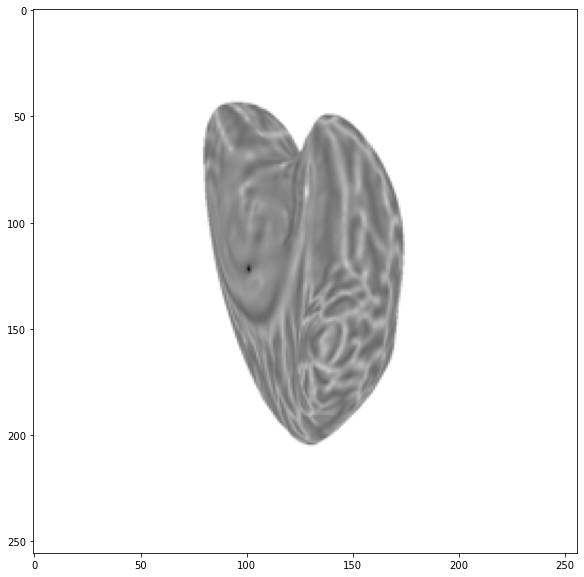

In [71]:
ind = 0

fig, ax = plt.subplots(figsize=(10, 10))
#plt.imshow(pred_am[ind], cmap='tab20')
plt.imshow(xv_np[ind], cmap='gray')

In [72]:
# check: class 2 is the OTS
np.unique(pred_np, return_counts=True)

(array([0, 1, 2, 3, 5]), array([1783543,  294342,    8664,    9854,     749]))

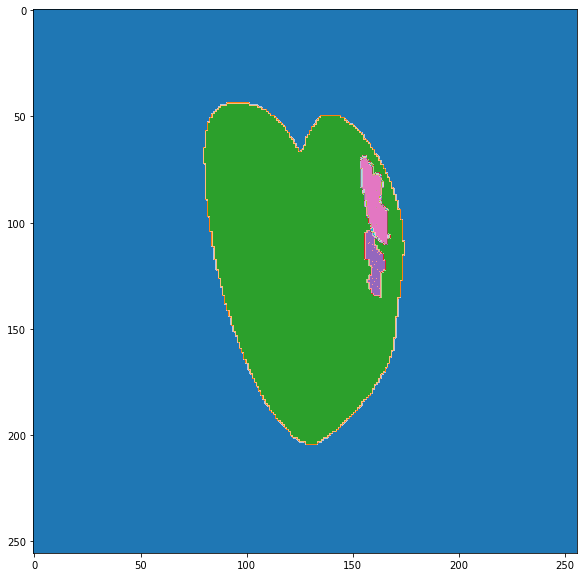

In [73]:
ind = 0

fig, ax = plt.subplots(figsize=(10, 10))
#plt.imshow(pred_am[ind], cmap='tab20')
plt.imshow(yv_np[ind], cmap='tab20')

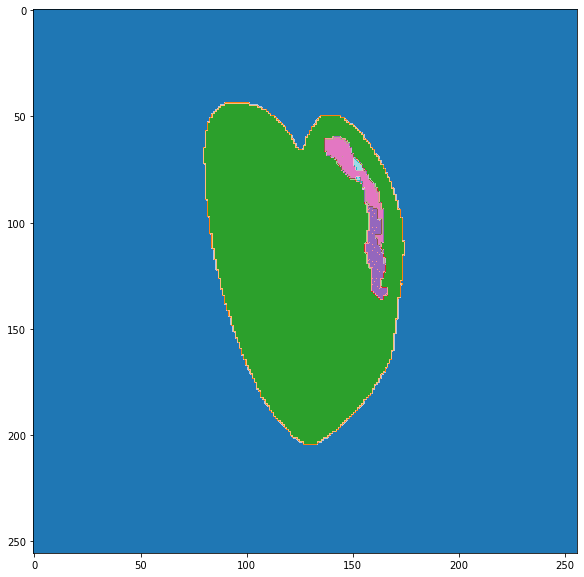

In [74]:
fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(pred_np[ind], cmap='tab20')

In [75]:
pind = (pred_np == 2)
yind = (yv_np == 2)

tp = np.logical_and(yind, pind)
tn = np.logical_and(~yind, ~pind)
fp = np.logical_and(~yind, pind)
fn = np.logical_and(yind, ~pind)

diff = np.zeros_like(pred_np)
diff[tp] = 1.0
diff[fp] = 3.0
diff[fn] = -1.0

In [76]:
pind = (pred_trn_np == 2)
yind = (yt_np == 2)

tp = np.logical_and(yind, pind)
tn = np.logical_and(~yind, ~pind)
fp = np.logical_and(~yind, pind)
fn = np.logical_and(yind, ~pind)

diff = np.zeros_like(pred_np)
diff[tp] = 1.0
diff[fp] = 3.0
diff[fn] = -1.0

Text(0.5, 1.0, 'Hits and Misses of OTS Labeling: One Subject')

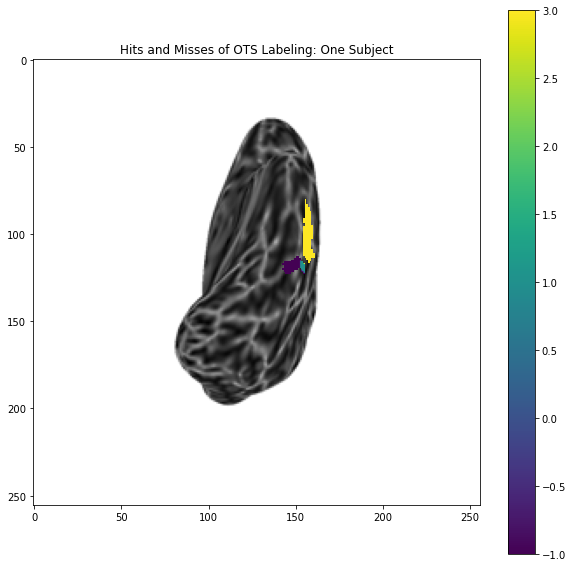

In [85]:
ind = 7

fig, ax = plt.subplots(figsize=(10, 10))
diff_masked = np.ma.masked_where(diff == 0, diff)
plt.imshow(xv_np[ind], cmap='gray')
plt.imshow(diff_masked[ind], cmap='viridis')
plt.colorbar()
plt.title('Hits and Misses of OTS Labeling: One Subject')

Text(0.5, 1.0, 'Hits and Misses of OTS Labeling: One Subject')

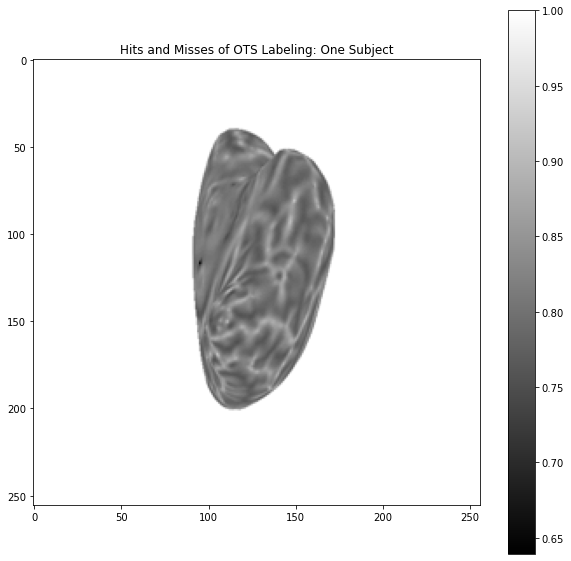

In [109]:
fig, ax = plt.subplots(figsize=(10, 10))
diff_masked = np.ma.masked_where(diff == 0, diff)
plt.imshow(xv_np[ind], cmap='gray')
#plt.imshow(diff_masked[ind], cmap='viridis')
plt.colorbar()
plt.title('Hits and Misses of OTS Labeling: One Subject')

## 3.1 Visualize results on vertex mesh

### 3.1.1 Load pixel2vertex maps

In [39]:
def parse_fname(fname, aloc=0, tloc=2):
    eid = fname[:16]
    other = fname[17:-4]
    split = other.split('-')
    ftype = split[-1]
    for i in range(len(split) - 1):
        if split[i] == '':
            split[i+1] = '-' + split[i+1]
    split = [c for c in split if c != '']
    shifts = [int(split[tloc]), int(split[tloc+1])]
    angles = [float(split[aloc]), float(split[aloc+1])]
    return eid, ftype, angles, shifts

In [40]:
img_base_dir = '/scratch/groups/jyeatman/samjohns-projects/data/parc-images-jitter-processed/'
vdir = os.path.join(img_base_dir, 'vertex_maps_val')
vfns = os.listdir(vdir)

In [41]:
df_px2vx = pd.DataFrame({'Filename': vfns})
df_px2vx['EID'] = df_px2vx['Filename'].apply(lambda f: parse_fname(f)[0])
df_px2vx['Type'] = df_px2vx['Filename'].apply(lambda f: parse_fname(f)[1])
df_px2vx['Angles'] = df_px2vx['Filename'].apply(lambda f: parse_fname(f)[2])
df_px2vx['Shifts'] = df_px2vx['Filename'].apply(lambda f: parse_fname(f)[3])

### 3.1.2 Match to batch elements

In [127]:
import nilearn as ni
import nilearn.surface as surface
import nilearn.plotting as plotting

In [128]:
def load_surface(subj_dir):
    surf_dir = os.path.join(subj_dir, 'surf')
    infl = surface.load_surf_mesh(os.path.join(surf_dir, 'lh.inflated'))
    curv = surface.load_surf_data(os.path.join(surf_dir, 'lh.curv'))
    return infl, curv

def load_pkl(fpath):
    with open(fpath, 'rb') as f:
        obj = pickle.load(f)
    return obj

def px_2_coord(vcoords, pcoords, px_vertex_dict, distance_dict=False):
    coords_vert_recon = np.zeros_like(vcoords)
    for k, v in px_vertex_dict.items():
        i, j = k  # unpack k
        coord = pcoords[i, j, :]
        for vertex in v:
            if distance_dict:
                vertex = vertex[0]
            coords_vert_recon[vertex] = coord
    return coords_vert_recon

In [129]:
hbn_dir = '/oak/stanford/groups/jyeatman/HBN/BIDS_curated/derivatives/freesurfer'

In [130]:
first_batch = ds_val.mapping_df[:32]
first_batch['EID'] = first_batch['ID'].apply(lambda s: s[:16])
df_all = pd.merge(first_batch, df_px2vx, on='EID', how='left')

In [131]:
eid = first_batch['EID'].iloc[0]

In [132]:
infl, curv = load_surface(os.path.join(hbn_dir, eid))
vcoords = infl.coordinates

In [133]:
df_all[df_all.EID==eid]

,Xname,Yname,ID,EID,Filename,Type,Angles,Shifts
0,sub-NDARDU602LPX-206.64-85.88-curv-trans--2--1...,sub-NDARDU602LPX-206.64-85.88-parc-trans--2--1...,sub-NDARDU602LPX-206.64-85.88--trans--2--19,sub-NDARDU602LPX,sub-NDARDU602LPX-206.64-85.88--2--19-vx2coord.pkl,vx2coord,"[206.64, 85.88]","[-2, -19]"
1,sub-NDARDU602LPX-206.64-85.88-curv-trans--2--1...,sub-NDARDU602LPX-206.64-85.88-parc-trans--2--1...,sub-NDARDU602LPX-206.64-85.88--trans--2--19,sub-NDARDU602LPX,sub-NDARDU602LPX-206.64-85.88--2--19-pcoord.pkl,pcoord,"[206.64, 85.88]","[-2, -19]"


In [134]:
eids = list(first_batch['EID'])

In [135]:
eid = eids[0]

In [136]:
vx_fname = df_all[df_all.EID==eid].iloc[0]['Filename']
px_fname = df_all[df_all.EID==eid].iloc[1]['Filename']

vx_coord = load_pkl(f'{vdir}/{vx_fname}')
px_coord = load_pkl(f'{vdir}/{px_fname}')

In [137]:
yvs = yv.argmax(dim=1).cpu().numpy()
predvs = pred.argmax(dim=1).cpu().numpy()
with open('yvs.pkl', 'wb') as f:
    pickle.dump(yvs, f)
with open('predvs.pkl', 'wb') as f:
    pickle.dump(predvs, f)

In [49]:
y0 = yvs[0]
p0 = predvs[0]

In [139]:
def px2vx(px_np, px2vx_dict, vcoords):
    vlen = vcoords.shape[0]
    vmap = np.zeros(vlen)
    n1 = px_np.shape[0]
    n2 = px_np.shape[1]
    for i in range(n1):
        for j in range(n2):
            v = px2vx_dict[(i, j)]
            vmap[v] = px_np[i, j]
    return vmap

In [154]:
vcoords_recon = px_2_coord(vcoords, px_coord, vx_coord, distance_dict=False)
squared_euclidean_errors = np.square(vcoords_recon - vcoords).sum(axis=1)
average_distance_error = np.mean(np.sqrt(squared_euclidean_errors))
print('Avg distance error:', average_distance_error)

# plt.hist(squared_euclidean_errors, bins=1000)
# plt.xlim(0, 100)
# plt.show()

surf_map_recon = np.zeros_like(vcoords[:, 0])
mask = squared_euclidean_errors > 5.0
surf_map_recon[mask] = 1.0

Avg distance error: 8.437689895494522


In [155]:
surf_map_recon.sum()

113817.0

In [156]:
vmap_y = px2vx(y0, vx_coord, vcoords)
vmap_p = px2vx(p0, vx_coord, vcoords)

In [157]:
vmap_y.shape, mask.shape

((160393,), (160393,))

In [158]:
surface_bg = 1.0
vmap_y_masked = vmap_y[:]
vmap_y_masked[mask] = surface_bg

In [159]:
vmap_p_masked = vmap_p[:]
vmap_p_masked[mask] = surface_bg

In [160]:
y_view = plotting.view_surf(infl, vmap_y_masked, cmap='tab20', threshold=1.5)
p_view = plotting.view_surf(infl, vmap_p_masked, cmap='tab20', threshold=1.5)

In [161]:
y_view

In [162]:
p_view

In [163]:
p_view.save_as_html('sub0-predicted-interactive-smallthresh.html')
y_view.save_as_html('sub0-target-interactive-smallthresh.html')

## 3.2 Calculate DICE

In [68]:
labels = list(range(2, 20)) # omits 0 and 1 (image background and cortex background, respectively)

In [69]:
def dice(target, prediction, label):
    """ Calculates DICE by comparing target to prediction.
        'label' is the value of the label to compare.
    """
    lt = target == label
    lp = prediction == label

    tp = sum(lt * lp)
    fp = sum(lp) - tp
    fn = sum(lt) - tp
    dice = (2 * tp) / (2 * tp + fp + fn)
    
    return dice

def average_dice(target, prediction, labels, return_all=False):
    dices = [dice(target, prediction, l) for l in labels]
    if return_all:
        return np.mean(dices), dices
    else:
        return np.mean(dices)

In [70]:
def make_surface_labels(ind):
    eid = eids[ind]
    vx_fname = (df_all[(df_all.EID==eid) & (df_all.Type=='vx2coord')]['Filename']).values[0]
    px_fname = (df_all[(df_all.EID==eid) & (df_all.Type=='pcoord')]['Filename']).values[0]

    vx_coord = load_pkl(f'{vdir}/{vx_fname}')
    px_coord = load_pkl(f'{vdir}/{px_fname}')
    
    # get target and prediction
    y = yvs[ind]
    p = predvs[ind]
    
    infl, curv = load_surface(os.path.join(hbn_dir, eid))
    vcoords = infl.coordinates
    
    vcoords_recon = px_2_coord(vcoords, px_coord, vx_coord, distance_dict=False)
    
    squared_euclidean_errors = np.square(vcoords_recon - vcoords).sum(axis=1)
    mask = squared_euclidean_errors > 10.0
    surface_bg = 1.0  # label (class) of cortex background
    
    vmap_y = px2vx(y, vx_coord, vcoords)
    vmap_p = px2vx(p, vx_coord, vcoords)
    vmap_y[mask] = surface_bg
    vmap_p[mask] = surface_bg
    return vmap_p, vmap_y

In [71]:
vmap_p, vmap_y = make_surface_labels(10)

In [72]:
vmap_p.shape, vmap_y.shape

((120102,), (120102,))

In [73]:
type(vmap_p)

numpy.ndarray

In [74]:
av, dices = average_dice(vmap_p, vmap_y, labels=labels, return_all=True)

In [75]:
np.mean(dices[dices != 0])  # some categories are not present

0.7877564749411369

In [76]:
vertex_dir = 'first32-vertex-labels-and-preds'
os.makedirs(vertex_dir, exist_ok=True)

In [77]:
dices_by_subject = []

for i in range(len(eids)):
    vmap_p, vmap_y = make_surface_labels(i)
    np.save(f'{vertex_dir}/{eids[i]}-predicted.npy', vmap_p)
    np.save(f'{vertex_dir}/{eids[i]}-target.npy', vmap_y)
    _, dices = average_dice(vmap_p, vmap_y, labels=labels, return_all=True)
    dices_by_subject.append(dices)
    print(f'Subjects completed: {i} ....')

Subjects completed: 0 ....
Subjects completed: 1 ....
Subjects completed: 2 ....
Subjects completed: 3 ....
Subjects completed: 4 ....
Subjects completed: 5 ....


KeyboardInterrupt: 

In [ ]:
dbs = np.array(dices_by_subject)

In [116]:
mean_dice_by_class = dbs.mean(axis=0)

Text(0.5, 1.0, 'Mean DICE by class - Test batch (32 subjects)')

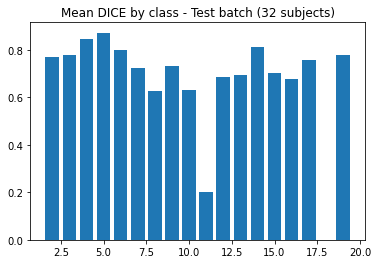

In [117]:
plt.bar(list(range(2, 20)), mean_dice_by_class)
plt.title('Mean DICE by class - Test batch (32 subjects)')

In [ ]:
np.save('dices_by_subject.npy', dbs)

In [114]:
dbs = np.load('dices_by_subject.npy')

In [ ]:
np.nanmean(dbs)

In [ ]:
os.listdir(vertex_dir)

In [82]:
saved = os.listdir(vertex_dir)
nps = [np.load(f'{vertex_dir}/{s}') for s in saved]

In [83]:
df_labels = pd.DataFrame({'FileName': saved, 'LabelFile': nps})

In [84]:
df_labels['Type'] = df_labels['FileName'].apply(lambda s: s[:-4].split('-')[-1])

In [85]:
df_labels['EID'] = df_labels['FileName'].apply(lambda s: s[:16])

In [86]:
df_labels

,FileName,LabelFile,Type,EID
0,sub-NDARJK842BCN-predicted.npy,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",predicted,sub-NDARJK842BCN
1,sub-NDARPY458LTR-predicted.npy,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",predicted,sub-NDARPY458LTR
2,sub-NDARTF776EYR-target.npy,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",target,sub-NDARTF776EYR
3,sub-NDARAX283MAK-predicted.npy,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",predicted,sub-NDARAX283MAK
4,sub-NDARHG188YE9-predicted.npy,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",predicted,sub-NDARHG188YE9
...,...,...,...,...
59,sub-NDARJR437DJH-target.npy,"[1.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, ...",target,sub-NDARJR437DJH
60,sub-NDARBF176LPM-target.npy,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",target,sub-NDARBF176LPM
61,sub-NDARYM257RR6-predicted.npy,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",predicted,sub-NDARYM257RR6
62,sub-NDARNZ084JVC-target.npy,"[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, ...",target,sub-NDARNZ084JVC


In [87]:
def load_surface(subj_dir):
    surf_dir = os.path.join(subj_dir, 'surf')
    infl = surface.load_surf_mesh(os.path.join(surf_dir, 'lh.inflated'))
    curv = surface.load_surf_data(os.path.join(surf_dir, 'lh.curv'))
    return infl, curv

In [88]:
eids = df_labels['EID']

In [164]:
eid = eids[0]

In [165]:
infl, curv = load_surface(f'{hbn_dir}/{eid}')

In [173]:
predicted = df_labels[(df_labels.EID==eid) & (df_labels.Type=='predicted')]
targets = df_labels[(df_labels.EID==eid) & (df_labels.Type=='target')]

predicted = predicted['LabelFile'].values[0]
targets = targets['LabelFile'].values[0]

In [178]:
cl = 4.0
diff = (targets == cl) - 2.0 * (predicted == cl)

In [179]:
predicted.shape

(160393,)

In [180]:
v = plotting.view_surf(infl, diff, bg_map=curv, threshold=0.1)

In [181]:
v.save_as_html('sub0-label4.html')

# 4. Transfer learning: run regression

- Define datasets / dataloaders
- Define model
- Initialize parameters from UNet
- Train

## 4.1 Make dataset

- dataset and dataloaders for HBN data

In [7]:
# image data and (pretrained) model data

base_dir ='/scratch/groups/jyeatman/samjohns-projects'
reg_save_dir = f'{base_dir}/models/unet-regression/6-22.1'
os.makedirs(reg_save_dir, exist_ok=True)
data_dir_base = '/scratch/groups/jyeatman/samjohns-projects/data'
xdir = '/scratch/groups/jyeatman/samjohns-projects/data/parc-images-jitter-processed/curv-trans'
ydir_pheno = data_dir_base + '/hbn-reading-age-data'

model_save_dir = './model_checkpoints_parcellation-5-13.2'
os.makedirs(model_save_dir, exist_ok=True)

### Skip this section if dataframe is already made

In [11]:
# (y) phenotypic data processing

ydir_pheno = '../data/hbn-reading-age-data'
age_df = pd.read_csv(ydir_pheno + '/hbn_ages_blanks.csv', header=None)
read_df = pd.read_csv(ydir_pheno + '/wiat_reading.csv', header=None)
age_df.columns = ['EID', 'Age']
read_df.columns = ['EID', 'Read']
age_df = age_df[age_df.Age != ' ']
read_df = read_df[read_df.Read != ' ']

df_y = pd.merge(age_df, read_df, on='EID', how='left')
df_y = df_y.dropna()
df_y.columns = ['EID', 'Age', 'Read']

In [8]:
# (x) image data

x_fnames = os.listdir(xdir)
x_eids = [s[:16] for s in x_fnames]
df_x = pd.DataFrame({'EID': x_eids, 'Filename': x_fnames})

In [9]:
# combined data

df_xy = pd.merge(df_x, df_y, on='EID', how='left')
df_xy = df_xy.dropna()
df_xy = df_xy.reindex(columns=['Filename', 'Read', 'Age', 'EID'])

# save out label file

regression_mapping_fname = f'{data_dir_base}/mapping_regression.csv'
save = True
if save:
    df_xy.to_csv(regression_mapping_fname, index=False)

In [13]:
# df_map_test = pd.read_csv(regression_mapping_fname)
# df_map_test.head()

# NB: Load from here if regression file is already made

In [32]:
df_xy = pd.read_csv(f'{data_dir_base}/mapping_regression.csv')
df_xy.head()

,Filename,Read,Age,EID
0,sub-NDARDU602LPX-206.64-85.88-curv-trans--2--1...,107.0,12,sub-NDARDU602LPX
1,sub-NDARWE818UA6-219.09-76.41-curv-trans--16-8...,110.0,16,sub-NDARWE818UA6
2,sub-NDARMA598JTX-212.60-95.18-curv-trans-0-0.npy,76.0,8,sub-NDARMA598JTX
3,sub-NDARXB286YBR-212.59-97.32-curv-trans--9-9.npy,107.0,8,sub-NDARXB286YBR
4,sub-NDARME930DE7-220.39-89.77-curv-trans--18--...,97.0,10,sub-NDARME930DE7


In [37]:
# split data into train and test, respecting EIDs

eids = list(set(df_xy['EID']))
n_eids = len(eids)
test_eids = list(np.random.choice(eids, size=n_eids//10, replace=False))
train_eids = list(set(eids) - set(test_eids))
indices = list(range(len(df_xy)))

df_xy['Index'] = indices
df_xy['Test'] = df_xy['EID'].isin(test_eids)


In [ ]:
df_xy.to_csv(f'{data_dir_base}/pca-dataset.csv', index=False)

## NB: Load from here if df_xy with indices is already created

In [8]:
df_path = f'{data_dir_base}/pca-dataset.csv'
df_xy = pd.read_csv(df_path)

In [9]:
test_indices = list(df_xy[df_xy.Test==True]['Index'])
train_indices = list(df_xy[df_xy.Test==False]['Index'])

In [10]:
# save out test, train split
save = False
if save:
    with open(f'{reg_save_dir}/test-train-indices.pkl', 'wb') as f:
        pickle.dump({'train': train_indices, 'test': test_indices}, f)

## Define dataset and dataloaders

In [11]:
# dataset
trf = transforms.Compose([transforms.ToTensor(), user.data.ToFloat()])
ds = user.data.CustomImageDataset(df_path,
                                  xdir, transform=trf, target_transform=user.data.ToFloat(),
                                  npy=True)
# test split
ds_train = torch.utils.data.Subset(ds, train_indices)
ds_test = torch.utils.data.Subset(ds, test_indices)

# dataloaders
bs = 32
dl_train = DataLoader(ds_train, batch_size=bs, shuffle=False)
dl_test = DataLoader(ds_test, batch_size=bs, shuffle=False)

In [12]:
tx, ty = next(iter(dl_train))
tx.shape, ty.shape, tx.dtype, ty.dtype

(torch.Size([32, 1, 256, 256]), torch.Size([32]), torch.float32, torch.float32)

## 4.2 Define model + initialize parameters

In [13]:
model_fp = f'{model_save_dir}/model009000.pkl'
pretrained_params = torch.load(model_fp)

In [14]:
class LNet(unet.UNet):
    def __init__(self, feature_count, class_count, fc_list=None,
                 pretrained_weights=None,
                 apply_sigmoid=False, return_type=None):
        super().__init__(feature_count=feature_count, 
                         class_count=class_count,
                         apply_sigmoid=apply_sigmoid)
        
        # load weights into UNet backbone
        if pretrained_weights is not None:
            if not isinstance(pretrained_weights, collections.OrderedDict):
                raise TypeError('Must be Pytorch params, which are an Ordered Dict.')
            else:
                self.load_state_dict(pretrained_weights)
        
        self.pool = nn.AdaptiveAvgPool2d(output_size=(1, 1))
        
        # parse return-type inputs
        if return_type is None:
            self.return_type = 'Prediction'
        else:
            self.return_type = return_type          
        
        # parse fc inputs
        manual_pool = True
        if manual_pool:
            fc_in = 512
        else:
            fc_in = 1000

        if fc_list is None:
            fc_list = [256, 64, 1]
        fcs = [fc_in] + fc_list
        self.fcs = nn.ModuleList()
        for i, o in zip(fcs[:-1], fcs[1:]):
            self.fcs.append(nn.Linear(i, o))
            
        # cache middle state
        self.middle = None
            
    def forward(self, x):
        x = self.layer0(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        # return the middle layer
        if self.return_type == 'middle':
            return x
        # otherwise, continue...
        x = self.pool(x)
        x = torch.flatten(x, start_dim=1)
        if self.return_type == 'middle_flat':
            return x
        for fc in self.fcs:
            x = F.elu(fc(x))
        return x

In [15]:
n_orig_classes = 21
in_channels = 1
lnet = LNet(feature_count=in_channels, class_count=n_orig_classes, return_type='middle_flat')

In [16]:
device = user.utils.get_device()
lnet.to(device)
device

device(type='cuda', index=0)

In [17]:
summary(lnet, (1, 256, 256))

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 64, 128, 128]        --
├─ResNet: 1                              []                        --
|    └─Conv2d: 2-1                       [-1, 64, 128, 128]        3,136
├─Sequential: 1                          []                        --
|    └─Conv2d: 2-2                       [-1, 64, 128, 128]        (recursive)
├─ResNet: 1                              []                        --
|    └─BatchNorm2d: 2-3                  [-1, 64, 128, 128]        128
├─Sequential: 1                          []                        --
|    └─BatchNorm2d: 2-4                  [-1, 64, 128, 128]        (recursive)
├─ResNet: 1                              []                        --
|    └─ReLU: 2-5                         [-1, 64, 128, 128]        --
├─Sequential: 1                          []                        --
|    └─ReLU: 2-6                         [-1, 64, 128, 128]    

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 64, 128, 128]        --
├─ResNet: 1                              []                        --
|    └─Conv2d: 2-1                       [-1, 64, 128, 128]        3,136
├─Sequential: 1                          []                        --
|    └─Conv2d: 2-2                       [-1, 64, 128, 128]        (recursive)
├─ResNet: 1                              []                        --
|    └─BatchNorm2d: 2-3                  [-1, 64, 128, 128]        128
├─Sequential: 1                          []                        --
|    └─BatchNorm2d: 2-4                  [-1, 64, 128, 128]        (recursive)
├─ResNet: 1                              []                        --
|    └─ReLU: 2-5                         [-1, 64, 128, 128]        --
├─Sequential: 1                          []                        --
|    └─ReLU: 2-6                         [-1, 64, 128, 128]    

In [18]:
def make_pretrained_state_dict(model_state, pretrained_state):
    pd = pretrained_state
    sd = model_state
    warmstart_params = copy.deepcopy(sd)
    for k, v in pd.items():
        warmstart_params[k] = v
    return warmstart_params

model_fp = f'{model_save_dir}/model009000.pkl'
pretrained_params = torch.load(model_fp)

warmstart_params = make_pretrained_state_dict(tlunet.state_dict(), pretrained_params)
tlunet.load_state_dict(warmstart_params)

## Investigate middle layer output

In [44]:
bs = dl_train.batch_size
ntrain = len(dl_train.dataset.indices)
ntest = len(dl_test.dataset.indices)
btrain = ntrain // bs
btest = ntest // bs

di_train = iter(dl_train)

In [46]:
N = 5
for n in range(N):
    X_list = []
    Y_list = []
    for i in range(btrain//N):
        x, y = next(di_train)
        x = x.to(device)
        y_np = y.numpy()
        yhat = lnet(x)
        yhat_np = yhat.detach().cpu().numpy()
        X_list.append(yhat_np[:])
        Y_list.append(y_np[:])
        if i % 50 == 0:
            print(f'Processed {i} of {btrain} batches....')
    X_np = np.concatenate(X_list)
    Y_np = np.concatenate(Y_list)

    with open(f'X_pca_{n}.pkl', 'wb') as f:
        pickle.dump(X_np, f)
    with open(f'Y_pca.pkl_{n}', 'wb') as f:
        pickle.dump(Y_np, f)


Processed 0 of 7327 batches....
Processed 50 of 7327 batches....
Processed 100 of 7327 batches....
Processed 150 of 7327 batches....
Processed 200 of 7327 batches....
Processed 250 of 7327 batches....
Processed 300 of 7327 batches....
Processed 350 of 7327 batches....
Processed 400 of 7327 batches....
Processed 450 of 7327 batches....
Processed 500 of 7327 batches....
Processed 550 of 7327 batches....
Processed 600 of 7327 batches....
Processed 650 of 7327 batches....
Processed 700 of 7327 batches....
Processed 750 of 7327 batches....
Processed 800 of 7327 batches....
Processed 850 of 7327 batches....
Processed 900 of 7327 batches....
Processed 950 of 7327 batches....
Processed 1000 of 7327 batches....
Processed 1050 of 7327 batches....
Processed 1100 of 7327 batches....
Processed 1150 of 7327 batches....
Processed 1200 of 7327 batches....
Processed 1250 of 7327 batches....
Processed 1300 of 7327 batches....
Processed 1350 of 7327 batches....
Processed 1400 of 7327 batches....
Processe

In [27]:
with open('X_pca.pkl', 'wb') as f:
    pickle.dump(X_np, f)
with open('Y_pca.pkl', 'wb') as f:
    pickle.dump(Y_np, f)

## 4.3 Train regression model

In [43]:
dl_dict = {'trn': dl_train, 'val': dl_test}

In [59]:
# in-place freeze beginning layers

layers_to_unfreeze = [lnet.base_model.layer4, # last conv block layer of base model
                      lnet.base_model.fc,  # last layer of base model
                      lnet.base_model.avgpool,  # second-to-last layer of base model
                      lnet.fcs]
user.utils.set_unfreeze_(lnet, layers_to_unfreeze)
user.utils.check_requires_grad(lnet.base_model.layer3)  # e.g.

False

In [67]:

model = lnet
mse = nn.MSELoss()

lr = 1e-2
optimizer = torch.optim.Adam(
    filter(lambda p: p.requires_grad, model.parameters()), lr=lr)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(
    optimizer, patience=100, verbose=True)

In [68]:
def train(model, loss, optimzer, dl_dict, nbatches, save_path, rp=5, cp=100, scheduler=None):
    """ Train loop.
    """
    
    losses = {'trn': [], 'val': []}
    dis = {'trn': iter(dl_dict['trn']), 'val': iter(dl_dict['val'])}
    
    for i in range(nbatches):
        if i % cp == 0 or i % rp == 0:
            # only do val if checkpoint or report point
            phases = ['trn', 'val']
        else:
            phases = ['trn']
        for phase in phases:
            dl = dl_dict[phase]
            di = dis[phase]
            # data
            try:
                # samples the batch
                x, y = next(di)
                x = x.to(device)
                y = y.to(device)
            except StopIteration:
                # restart the generator if epoch ends
                di = iter(dl_dict[phase])
                dis[phase] = di  # ensure dictionary is updated
                x, y = next(di)
                x = x.to(device)
                y = y.to(device)
            if phase == 'trn':
                model.train()
                with torch.set_grad_enabled(True):
                    ypred = model(x)
                    l = loss(ypred, y)
                    l.backward()
                    optimizer.step()
                    if rp:
                        losses[phase].append(l.data.cpu().numpy())
                        
            else:
                model.eval()
                with torch.set_grad_enabled(False):
                    ypred = model(x)
                    l = loss(ypred, y)
                    if rp:
                        losses[phase].append(l.data.cpu().numpy())
                        # report
                        trn_loss = losses['trn'][-1]
                        val_loss = losses['val'][-1]
                        print(f'Batch: {i} ## Train loss:' 
                              f'## {trn_loss} ## Val loss: {val_loss}')

                # update learning rates if necessary
                if scheduler is not None:
                    scheduler.step(l)
                
            if cp:
                save_name = os.path.join(save_path, "model%06d.pkl" % i)
                torch.save(model.state_dict(), save_name)
                save_name = os.path.join(save_path, "optim%06d.pkl" % i)
                torch.save(optimizer.state_dict(), save_name)
                with open(f'{save_path}/loss_history_{i}.pkl', 'wb') as f:
                    pickle.dump(losses, f)
        
    return model, losses

In [70]:
reg_save_dir = '/scratch/groups/jyeatman/samjohns-projects/models/unet-regression/' + '6.22.3'
print(reg_save_dir)
os.makedirs(reg_save_dir)

/scratch/groups/jyeatman/samjohns-projects/models/unet-regression/6.22.3


In [ ]:
train(lnet, mse, optimizer, dl_dict, nbatches=int(1e5), save_path=reg_save_dir, scheduler=scheduler)

Batch: 0 ## Train loss:## 11324.6875 ## Val loss: 11307.9375
Batch: 5 ## Train loss:## 10586.1875 ## Val loss: 12982.875
Batch: 10 ## Train loss:## 10909.46875 ## Val loss: 10481.53125
Batch: 15 ## Train loss:## 12345.65625 ## Val loss: 11148.875
Batch: 20 ## Train loss:## 11513.5625 ## Val loss: 12315.15625
Batch: 25 ## Train loss:## 11734.25 ## Val loss: 12286.9375
Batch: 30 ## Train loss:## 10295.21875 ## Val loss: 11671.9375
Batch: 35 ## Train loss:## 11300.71875 ## Val loss: 11957.28125
Batch: 40 ## Train loss:## 11648.0 ## Val loss: 12104.375
Batch: 45 ## Train loss:## 11602.75 ## Val loss: 12045.0625
Batch: 50 ## Train loss:## 11187.6875 ## Val loss: 13126.625
Batch: 55 ## Train loss:## 11795.6875 ## Val loss: 12222.09375
Batch: 60 ## Train loss:## 11096.15625 ## Val loss: 12867.15625
Batch: 65 ## Train loss:## 11382.65625 ## Val loss: 11651.3125
Batch: 70 ## Train loss:## 11575.3125 ## Val loss: 11872.90625
Batch: 75 ## Train loss:## 11358.90625 ## Val loss: 12209.6875
Batch: 8

Batch: 655 ## Train loss:## 11339.65625 ## Val loss: 11797.21875
Batch: 660 ## Train loss:## 12806.5625 ## Val loss: 11090.25
Batch: 665 ## Train loss:## 10241.34375 ## Val loss: 12271.65625
Batch: 670 ## Train loss:## 10688.21875 ## Val loss: 12168.875
Batch: 675 ## Train loss:## 10648.90625 ## Val loss: 11827.0
Batch: 680 ## Train loss:## 12332.71875 ## Val loss: 11722.3125
Batch: 685 ## Train loss:## 11317.375 ## Val loss: 11238.5625
Batch: 690 ## Train loss:## 11442.46875 ## Val loss: 12458.28125
Batch: 695 ## Train loss:## 11293.6875 ## Val loss: 10964.53125
Batch: 700 ## Train loss:## 11680.96875 ## Val loss: 11426.71875
Batch: 705 ## Train loss:## 12177.875 ## Val loss: 12161.5
Batch: 710 ## Train loss:## 11290.71875 ## Val loss: 12126.375
Batch: 715 ## Train loss:## 10603.03125 ## Val loss: 12237.53125
Batch: 720 ## Train loss:## 11724.3125 ## Val loss: 10993.21875
Batch: 725 ## Train loss:## 11604.96875 ## Val loss: 12128.25
Batch: 730 ## Train loss:## 12312.4375 ## Val loss: 

Batch: 1305 ## Train loss:## 10316.3125 ## Val loss: 12139.53125
Batch: 1310 ## Train loss:## 11218.46875 ## Val loss: 11771.59375
Batch: 1315 ## Train loss:## 10851.9375 ## Val loss: 10548.65625
Batch: 1320 ## Train loss:## 12348.0 ## Val loss: 11951.71875
Batch: 1325 ## Train loss:## 10545.53125 ## Val loss: 11533.15625
Batch: 1330 ## Train loss:## 11213.0 ## Val loss: 11877.71875
Batch: 1335 ## Train loss:## 11365.28125 ## Val loss: 11858.8125
Batch: 1340 ## Train loss:## 10848.84375 ## Val loss: 12050.1875
Batch: 1345 ## Train loss:## 11202.3125 ## Val loss: 11293.34375
Batch: 1350 ## Train loss:## 11020.03125 ## Val loss: 11783.71875
Batch: 1355 ## Train loss:## 11772.03125 ## Val loss: 11855.53125
Epoch   272: reducing learning rate of group 0 to 1.0000e-03.
Batch: 1360 ## Train loss:## 11094.84375 ## Val loss: 11355.65625
Batch: 1365 ## Train loss:## 12849.21875 ## Val loss: 12649.25
Batch: 1370 ## Train loss:## 12307.875 ## Val loss: 11462.53125
Batch: 1375 ## Train loss:## 107

Batch: 1940 ## Train loss:## 12005.34375 ## Val loss: 12261.625
Batch: 1945 ## Train loss:## 12013.78125 ## Val loss: 11463.71875
Batch: 1950 ## Train loss:## 10800.25 ## Val loss: 12149.625
Batch: 1955 ## Train loss:## 11685.90625 ## Val loss: 12614.8125
Batch: 1960 ## Train loss:## 11445.6875 ## Val loss: 11063.25
Batch: 1965 ## Train loss:## 12462.46875 ## Val loss: 11812.15625
Batch: 1970 ## Train loss:## 10337.96875 ## Val loss: 12687.1875
Batch: 1975 ## Train loss:## 10213.46875 ## Val loss: 12247.40625
Batch: 1980 ## Train loss:## 11960.03125 ## Val loss: 11517.375
Batch: 1985 ## Train loss:## 11254.46875 ## Val loss: 11045.09375
Batch: 1990 ## Train loss:## 11277.34375 ## Val loss: 11875.46875
Batch: 1995 ## Train loss:## 11626.0625 ## Val loss: 11556.4375
Batch: 2000 ## Train loss:## 11425.03125 ## Val loss: 11025.125
Batch: 2005 ## Train loss:## 10433.75 ## Val loss: 12735.90625
Batch: 2010 ## Train loss:## 12016.625 ## Val loss: 11609.59375
Batch: 2015 ## Train loss:## 11305

Batch: 2570 ## Train loss:## 11485.3125 ## Val loss: 12960.0625
Batch: 2575 ## Train loss:## 11025.875 ## Val loss: 10743.03125
Batch: 2580 ## Train loss:## 10225.75 ## Val loss: 11389.28125
Batch: 2585 ## Train loss:## 11280.59375 ## Val loss: 11012.875
Batch: 2590 ## Train loss:## 11151.1875 ## Val loss: 12493.46875
Batch: 2595 ## Train loss:## 11394.65625 ## Val loss: 11950.6875
Batch: 2600 ## Train loss:## 11411.90625 ## Val loss: 11704.40625
Batch: 2605 ## Train loss:## 11135.9375 ## Val loss: 11717.5625
Batch: 2610 ## Train loss:## 10773.53125 ## Val loss: 12406.84375
Batch: 2615 ## Train loss:## 10418.3125 ## Val loss: 12996.90625
Batch: 2620 ## Train loss:## 10234.25 ## Val loss: 11663.875
Batch: 2625 ## Train loss:## 11510.4375 ## Val loss: 11834.90625
Batch: 2630 ## Train loss:## 12429.09375 ## Val loss: 11720.21875
Batch: 2635 ## Train loss:## 12811.125 ## Val loss: 11416.125
Batch: 2640 ## Train loss:## 10185.125 ## Val loss: 11696.25
Batch: 2645 ## Train loss:## 10892.625 

Batch: 3205 ## Train loss:## 10262.5 ## Val loss: 11436.9375
Batch: 3210 ## Train loss:## 11817.90625 ## Val loss: 11605.125
Batch: 3215 ## Train loss:## 11364.59375 ## Val loss: 11822.65625
Batch: 3220 ## Train loss:## 11788.53125 ## Val loss: 11837.5
Batch: 3225 ## Train loss:## 10294.4375 ## Val loss: 12750.90625
Batch: 3230 ## Train loss:## 11349.84375 ## Val loss: 11464.5
Batch: 3235 ## Train loss:## 11754.21875 ## Val loss: 11878.875
Batch: 3240 ## Train loss:## 11902.375 ## Val loss: 11362.59375
Batch: 3245 ## Train loss:## 10857.8125 ## Val loss: 10944.75
Batch: 3250 ## Train loss:## 10898.09375 ## Val loss: 11209.1875
Batch: 3255 ## Train loss:## 12003.625 ## Val loss: 12855.03125
Batch: 3260 ## Train loss:## 11560.3125 ## Val loss: 11493.71875
Batch: 3265 ## Train loss:## 11566.28125 ## Val loss: 11520.34375
Batch: 3270 ## Train loss:## 11721.125 ## Val loss: 11456.375
Batch: 3275 ## Train loss:## 10947.28125 ## Val loss: 10900.46875
Batch: 3280 ## Train loss:## 11129.53125 #

Batch: 3845 ## Train loss:## 11219.125 ## Val loss: 11709.8125
Batch: 3850 ## Train loss:## 12257.59375 ## Val loss: 12172.1875
Batch: 3855 ## Train loss:## 11824.0625 ## Val loss: 11048.53125
Batch: 3860 ## Train loss:## 11010.65625 ## Val loss: 11302.8125
Batch: 3865 ## Train loss:## 10543.53125 ## Val loss: 11573.96875
Batch: 3870 ## Train loss:## 12519.53125 ## Val loss: 12891.03125
Batch: 3875 ## Train loss:## 11179.90625 ## Val loss: 12842.875
Batch: 3880 ## Train loss:## 10358.9375 ## Val loss: 12241.375
Batch: 3885 ## Train loss:## 10406.125 ## Val loss: 12912.8125
Batch: 3890 ## Train loss:## 11215.1875 ## Val loss: 11472.78125
Batch: 3895 ## Train loss:## 10931.9375 ## Val loss: 11378.65625
Batch: 3900 ## Train loss:## 11363.4375 ## Val loss: 12295.8125
Batch: 3905 ## Train loss:## 12513.8125 ## Val loss: 11523.625
Batch: 3910 ## Train loss:## 11160.5625 ## Val loss: 11961.59375
Batch: 3915 ## Train loss:## 11728.5 ## Val loss: 11504.3125
Batch: 3920 ## Train loss:## 12248.78

Batch: 4480 ## Train loss:## 11436.15625 ## Val loss: 11388.9375
Batch: 4485 ## Train loss:## 12315.78125 ## Val loss: 11658.25
Batch: 4490 ## Train loss:## 11047.34375 ## Val loss: 10462.625
Batch: 4495 ## Train loss:## 11130.46875 ## Val loss: 10504.1875
Batch: 4500 ## Train loss:## 10266.15625 ## Val loss: 11480.59375
Batch: 4505 ## Train loss:## 11749.75 ## Val loss: 12522.15625
Batch: 4510 ## Train loss:## 11658.75 ## Val loss: 11868.0
Batch: 4515 ## Train loss:## 10574.75 ## Val loss: 10538.625
Batch: 4520 ## Train loss:## 11375.4375 ## Val loss: 12482.3125
Batch: 4525 ## Train loss:## 11521.40625 ## Val loss: 12266.90625
Batch: 4530 ## Train loss:## 11706.125 ## Val loss: 12135.75
Batch: 4535 ## Train loss:## 11102.96875 ## Val loss: 12046.90625
Batch: 4540 ## Train loss:## 11306.90625 ## Val loss: 11443.46875
Batch: 4545 ## Train loss:## 11934.0625 ## Val loss: 11664.9375
Batch: 4550 ## Train loss:## 10995.40625 ## Val loss: 11212.78125
Batch: 4555 ## Train loss:## 10529.375 ##

Batch: 5125 ## Train loss:## 10827.34375 ## Val loss: 12322.5
Batch: 5130 ## Train loss:## 10736.40625 ## Val loss: 12139.1875
Batch: 5135 ## Train loss:## 10700.78125 ## Val loss: 13235.28125
Batch: 5140 ## Train loss:## 11226.8125 ## Val loss: 12303.78125
Batch: 5145 ## Train loss:## 11534.28125 ## Val loss: 11991.59375
Batch: 5150 ## Train loss:## 11943.21875 ## Val loss: 11531.28125
Batch: 5155 ## Train loss:## 11830.8125 ## Val loss: 11486.6875
Batch: 5160 ## Train loss:## 11324.3125 ## Val loss: 12324.03125
Batch: 5165 ## Train loss:## 11531.875 ## Val loss: 11975.46875
Batch: 5170 ## Train loss:## 11598.90625 ## Val loss: 12256.375
Batch: 5175 ## Train loss:## 11108.71875 ## Val loss: 12495.40625
Batch: 5180 ## Train loss:## 11321.6875 ## Val loss: 11577.78125
Batch: 5185 ## Train loss:## 11551.125 ## Val loss: 11973.09375
Batch: 5190 ## Train loss:## 11206.0 ## Val loss: 10738.34375
Batch: 5195 ## Train loss:## 11459.34375 ## Val loss: 12199.5
Batch: 5200 ## Train loss:## 12447

Batch: 5765 ## Train loss:## 10026.96875 ## Val loss: 11676.53125
Batch: 5770 ## Train loss:## 11217.9375 ## Val loss: 11953.5625
Batch: 5775 ## Train loss:## 11573.4375 ## Val loss: 11859.4375
Batch: 5780 ## Train loss:## 12042.25 ## Val loss: 12324.0625
Batch: 5785 ## Train loss:## 11720.125 ## Val loss: 11742.8125
Batch: 5790 ## Train loss:## 10492.84375 ## Val loss: 11486.09375
Batch: 5795 ## Train loss:## 10865.34375 ## Val loss: 10914.34375
Batch: 5800 ## Train loss:## 11620.15625 ## Val loss: 11405.9375
Batch: 5805 ## Train loss:## 11136.625 ## Val loss: 12181.53125
Batch: 5810 ## Train loss:## 11043.1875 ## Val loss: 10588.6875
Batch: 5815 ## Train loss:## 10753.5625 ## Val loss: 11582.5
Batch: 5820 ## Train loss:## 11404.0625 ## Val loss: 12021.375
Batch: 5825 ## Train loss:## 10779.1875 ## Val loss: 11528.1875
Batch: 5830 ## Train loss:## 11101.1875 ## Val loss: 11340.03125
Batch: 5835 ## Train loss:## 11060.15625 ## Val loss: 11034.0
Batch: 5840 ## Train loss:## 11616.09375 

In [ ]:
reg_save_dir = '../models/unet-regression/6-15.3'
lr = 5e-4
optimizer = torch.optim.Adam(
    filter(lambda p: p.requires_grad, model.parameters()), lr=lr)
train(lnet, mse, optimizer, dl_dict, nbatches=int(1e5), save_path=reg_save_dir)